# Basic Preprocessing

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [5]:
# 0801 수정본, 기존 예보데이터 + 추가된 12년도 데이터 모두 합병(어제 해본 결과 추가된 데이터만으로 진행할 경우 다른 부분에서 결측이 존재)
import os
import re
from datetime import date, datetime, time, timezone, timedelta
import unicodedata
area = os.listdir("/Users/seong-yeseul/Downloads/예보데이터/" + str(2012))
area = [x for x in area if ".DS" not in x]
final = pd.DataFrame()
for a in area:
    for y in [x for x in os.listdir("/Users/seong-yeseul/Downloads/예보데이터") if ".DS" not in x]:
        print(a, y)
        list = os.listdir("/Users/seong-yeseul/Downloads/예보데이터/{0}/{1}".format(str(y), a))
        list = [x for x in list if "습도" in unicodedata.normalize("NFC", x)]
        for l in list:
            if l.split(".")[-1] == "csv":
                df = pd.read_csv("/Users/seong-yeseul/Downloads/예보데이터/{0}/{1}/".format(str(y), a)+l, encoding = "utf-8-sig")
            else:
                print("/Users/seong-yeseul/Downloads/예보데이터/{0}/{1}/".format(str(y), a)+l)
                df = pd.read_excel("/Users/seong-yeseul/Downloads/예보데이터/{0}/{1}/".format(str(y), a)+l)
            df.columns = ["day", "hour", "forecast", "value"]
            idx = []
            drop = []
            for i in range(df.shape[0]):
                if "format" in str(df.loc[i, "day"]):
                    drop.append(i)
            df = df.drop(drop, axis = 0).reset_index(drop = True)
            for i in range(df.shape[0]):
                if "Start" in str(df.loc[i, "day"]):
                    idx.append(i)
            df["year"] = int(str(y)[:4])
            df["month"] = ""
            for i in range(len(idx)):
                if i != len(idx)-1:
                    df.loc[idx[i]:idx[i+1], "month"] = int(str(df.loc[idx[i], "day"]).split(":")[1].strip()[4:6])
                else:
                    df.loc[idx[i]:, "month"] = int(str(df.loc[idx[i], "day"]).split(":")[1].strip()[4:6])
            df.loc[:idx[0], "month"] = int(str(df.loc[idx[0], "day"]).split(":")[1].strip()[4:6]) - 1
            df = df.drop(idx, axis = 0).reset_index(drop = True)
            #print(df["day"].unique())
            df = df.dropna().reset_index(drop = True)
            #print(df["day"].unique())
            df["day"] = df["day"].apply(lambda x: int(x))
            df["minute"] = df["hour"].apply(lambda x: int(int(x) % 100))
            df["hour"] = df["hour"].apply(lambda x: int(int(x) // 100))
            df["forecast"] = df["forecast"].apply(lambda x: int(x))
            # 현재시간 + 예보시간 + 9 (UTC -(+9)-> KST)
            df["tma"] = [datetime(x, y, z, w, m, 0) + timedelta(hours = t + 9) for x, y, z, w, m, t in zip(df["year"], df["month"], df["day"], df["hour"], df["minute"], df["forecast"])]
            df["tma"].apply(lambda x: x.strftime('%Y-%m-%d %H:%M:%S'))
            df.drop(["year", "month", "day", "hour", "minute"], axis = 1, inplace = True)
            df["yyyymmdd"] = df["tma"].apply(lambda x: int(str(x).split(" ")[0].strip().replace("-", "")))
            df["time"] = df["tma"].apply(lambda x: str(x).split(" ")[1].strip())
            df["add"] = a
            df["address"] = l.split("_")[0]
            final = pd.concat([final, df], axis = 0).reset_index(drop = True)
            del df
final
#[x.split("_")[0] for x in list]


광주 2013
광주 2014
광주 2015
광주 2012
광주 2012_예보데이터
광주 2016
세종 2013
세종 2014
세종 2015
세종 2012
세종 2012_예보데이터
세종 2016
제주 2013
제주 2014
제주 2015
제주 2012
제주 2012_예보데이터
제주 2016
경북 2013
경북 2014
경북 2015
경북 2012
경북 2012_예보데이터
경북 2016
경기 2013
경기 2014
경기 2015
경기 2012
경기 2012_예보데이터
경기 2016
인천 2013
인천 2014
인천 2015
인천 2012
인천 2012_예보데이터
인천 2016
충북 2013
충북 2014
충북 2015
충북 2012
충북 2012_예보데이터
충북 2016
전북 2013
전북 2014
전북 2015
전북 2012
전북 2012_예보데이터
전북 2016
전남 2013
전남 2014
전남 2015
전남 2012
전남 2012_예보데이터
전남 2016
대구 2013
대구 2014
대구 2015
대구 2012
대구 2012_예보데이터
대구 2016
대전 2013
대전 2014
대전 2015
대전 2012
대전 2012_예보데이터
대전 2016
서울 2013
서울 2014
서울 2015
서울 2012
서울 2012_예보데이터
서울 2016
부산 2013
부산 2014
부산 2015
부산 2012
부산 2012_예ᄇ

,forecast,value,tma,yyyymmdd,time,add,address
0,4,75.000000,2013-01-01 15:00:00,20130101,15:00:00,광주,운암1동
1,7,75.000000,2013-01-01 18:00:00,20130101,18:00:00,광주,운암1동
2,10,85.000000,2013-01-01 21:00:00,20130101,21:00:00,광주,운암1동
3,13,90.000000,2013-01-02 00:00:00,20130102,00:00:00,광주,운암1동
4,16,90.000000,2013-01-02 03:00:00,20130102,03:00:00,광주,운암1동
...,...,...,...,...,...,...,...
34276091,52,35.000000,2017-01-03 12:00:00,20170103,12:00:00,울산,병영2동
34276092,55,35.000000,2017-01-03 15:00:00,20170103,15:00:00,울산,병영2동
34276093,58,30.000000,2017-01-03 18:00:00,20170103,18:00:00,울산,병영2동
34276094,61,45.000000,2017-01-03 21:00:00,20170103,21:00:00,울산,병영2동


In [6]:
final.to_csv("fore_rhm_0801.csv", encoding = "utf-8-sig", index = False)

In [7]:
df1 = pd.read_csv("fore_rhm_0801.csv", encoding = "utf-8-sig")

In [8]:
# 누락데이터 추가본
final = pd.DataFrame()
add_list = [x for x in os.listdir("/Users/seong-yeseul/Downloads/rhm".format(a)) if "DS" not in x]
for a in add_list:
    for n in df1[df1["add"] == a]["address"].unique():
        print(a, n)
        list = os.listdir("/Users/seong-yeseul/Downloads/rhm/{0}".format(a))
        list = [x for x in list if unicodedata.normalize("NFC", n) in unicodedata.normalize("NFC", x)]
        for l in list:
            if l.split(".")[-1] == "csv":
                df = pd.read_csv("/Users/seong-yeseul/Downloads/rhm/{0}/".format(a)+l, encoding = "utf-8-sig")
            else:
                print("/Users/seong-yeseul/Downloads/rhm/{0}/".format(a)+l)
                df = pd.read_excel("/Users/seong-yeseul/Downloads/rhm/{0}/".format(a)+l)
            try:
                y = int(df.columns[-1].split("Start : ")[1].strip()[:4])
            except:
                print(df)
                continue
            df.columns = ["day", "hour", "forecast", "value"]
            display(df)
            idx = []
            drop = []
            for i in range(df.shape[0]):
                if "format" in str(df.loc[i, "day"]):
                    drop.append(i)
            df = df.drop(drop, axis = 0).reset_index(drop = True)
            for i in range(df.shape[0]):
                if "Start" in str(df.loc[i, "day"]):
                    idx.append(i)
            df["year"] = y
            df["month"] = ""
            for i in range(len(idx)):
                if i != len(idx)-1:
                    df.loc[idx[i]:idx[i+1], "month"] = int(str(df.loc[idx[i], "day"]).split(":")[1].strip()[4:6])
                else:
                    df.loc[idx[i]:, "month"] = int(str(df.loc[idx[i], "day"]).split(":")[1].strip()[4:6])
            df.loc[:idx[0], "month"] = int(str(df.loc[idx[0], "day"]).split(":")[1].strip()[4:6]) - 1
            df = df.drop(idx, axis = 0).reset_index(drop = True)
            #print(df["day"].unique())
            df = df.dropna().reset_index(drop = True)
            #print(df["day"].unique())
            df["day"] = df["day"].apply(lambda x: int(x))
            df["minute"] = df["hour"].apply(lambda x: int(int(x) % 100))
            df["hour"] = df["hour"].apply(lambda x: int(int(x) // 100))
            df["forecast"] = df["forecast"].apply(lambda x: int(x))
            # 현재시간 + 예보시간 + 9 (UTC -(+9)-> KST)
            try:
                df["tma"] = [datetime(x, y, z, w, m, 0) + timedelta(hours = t + 9) for x, y, z, w, m, t in zip(df["year"], df["month"], df["day"], df["hour"], df["minute"], df["forecast"])]
            except:
                print("check : ", l)
                del df
                continue
            df["tma"].apply(lambda x: x.strftime('%Y-%m-%d %H:%M:%S'))
            df.drop(["year", "month", "day", "hour", "minute"], axis = 1, inplace = True)
            df["yyyymmdd"] = df["tma"].apply(lambda x: int(str(x).split(" ")[0].strip().replace("-", "")))
            df["time"] = df["tma"].apply(lambda x: str(x).split(" ")[1].strip())
            df["add"] = unicodedata.normalize("NFC", a)
            address = l.split("_")[0]
            df["address"] = unicodedata.normalize("NFC", address)
            final = pd.concat([final, df], axis = 0).reset_index(drop = True)
            del df



광주 운암1동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,70.0


세종 새롬동


,day,hour,forecast,value
0,1,200.0,4.0,62.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,69.0
4,1,200.0,16.0,76.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,63.0
7193,21,2000.0,49.0,72.0
7194,21,2000.0,52.0,38.0


,day,hour,forecast,value
0,1,200.0,4.0,52.0
1,1,200.0,7.0,73.0
2,1,200.0,10.0,86.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,94.0
...,...,...,...,...
6593,13,500.0,34.0,94.0
6594,13,500.0,37.0,91.0
6595,13,500.0,40.0,92.0
6596,13,500.0,43.0,87.0


,day,hour,forecast,value
0,1,200.0,4.0,48.0
1,1,200.0,7.0,48.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,82.0
4,1,200.0,16.0,88.0
...,...,...,...,...
44572,31,2300.0,40.0,78.0
44573,31,2300.0,43.0,81.0
44574,31,2300.0,46.0,82.0
44575,31,2300.0,49.0,76.0


제주 정방동
Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:53_32 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,86.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,94.0
4,1,200.0,16.0,89.0
...,...,...,...,...
7191,21,2000.0,43.0,72.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,65.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,57.0
3,1,200.0,13.0,66.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,64.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,58.0


제주 한경면


,day,hour,forecast,value
0,1,200.0,4.0,79.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,80.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,68.0
7194,21,2000.0,52.0,63.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:46_35 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,64.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,58.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,65.0
...,...,...,...,...
44572,31,2300.0,40.0,61.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,59.0
44575,31,2300.0,49.0,60.0


제주 건입동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,65.0
7193,21,2000.0,49.0,55.0
7194,21,2000.0,52.0,50.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:53_38 ]
Index: []
제주 성산읍


,day,hour,forecast,value
0,1,200.0,4.0,73.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,58.0
3,1,200.0,13.0,78.0
4,1,200.0,16.0,77.0
...,...,...,...,...
44572,31,2300.0,40.0,67.0
44573,31,2300.0,43.0,71.0
44574,31,2300.0,46.0,72.0
44575,31,2300.0,49.0,69.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:60_37 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,95.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,81.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,55.0


경북 춘양면


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,90.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,90.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,50.0
4978,7,1700.0,37.0,40.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,75.0


,day,hour,forecast,value
0,1,0200,+4,40.000000
1,1,0200,+7,60.000000
2,1,0200,+10,75.000000
3,1,0200,+13,80.000000
4,1,0200,+16,90.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,50.000000
108357,31,2300,+61,65.000000


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,65.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,75.0
44575,31,2300.0,49.0,70.0


경북 평화동


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
4977,7,1700.0,34.0,50.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,65.0


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,55.000000
2,1,0200,+10,65.000000
3,1,0200,+13,75.000000
4,1,0200,+16,75.000000
...,...,...,...,...
108354,31,2300,+52,45.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,40.000000
108357,31,2300,+61,60.000000


경북 선주원남동


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,55.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,40.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,65.0
44575,31,2300.0,49.0,60.0


,day,hour,forecast,value
0,1,0200,+4,35.000000
1,1,0200,+7,50.000000
2,1,0200,+10,65.000000
3,1,0200,+13,70.000000
4,1,0200,+16,80.000000
...,...,...,...,...
108354,31,2300,+52,35.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,45.000000
108357,31,2300,+61,55.000000


경북 점촌4동


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,81.0
4,1,200.0,16.0,85.0
...,...,...,...,...
4977,7,1700.0,34.0,55.0
4978,7,1700.0,37.0,45.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,46.0
2,1,200.0,10.0,54.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,54.0
44573,31,2300.0,43.0,54.0
44574,31,2300.0,46.0,64.0
44575,31,2300.0,49.0,49.0


,day,hour,forecast,value
0,1,0200,+4,40.000000
1,1,0200,+7,65.000000
2,1,0200,+10,65.000000
3,1,0200,+13,70.000000
4,1,0200,+16,85.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,45.000000
108357,31,2300,+61,60.000000


경북 풍기읍


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
4977,7,1700.0,34.0,55.0
4978,7,1700.0,37.0,45.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,65.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,50.0
44573,31,2300.0,43.0,50.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,55.0


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,60.000000
2,1,0200,+10,70.000000
3,1,0200,+13,75.000000
4,1,0200,+16,80.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,50.000000
108357,31,2300,+61,60.000000


경북 남원동


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,55.000000
2,1,0200,+10,65.000000
3,1,0200,+13,70.000000
4,1,0200,+16,70.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,45.000000
108357,31,2300,+61,60.000000


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,50.0
44573,31,2300.0,43.0,50.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,60.0
7193,21,2000.0,49.0,60.0
7194,21,2000.0,52.0,35.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,90.0
...,...,...,...,...
4977,7,1700.0,34.0,55.0
4978,7,1700.0,37.0,45.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


경북 영해면


,day,hour,forecast,value
0,1,0200,+4,30.000000
1,1,0200,+7,41.000000
2,1,0200,+10,51.000000
3,1,0200,+13,56.000000
4,1,0200,+16,60.000000
...,...,...,...,...
108354,31,2300,+52,35.000000
108355,31,2300,+55,26.000000
108356,31,2300,+58,39.000000
108357,31,2300,+61,48.000000


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,40.0
44573,31,2300.0,43.0,40.0
44574,31,2300.0,46.0,45.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,84.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,60.0
7193,21,2000.0,49.0,51.0
7194,21,2000.0,52.0,42.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,95.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,50.0
4978,7,1700.0,37.0,40.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,75.0


경북 울진읍


,day,hour,forecast,value
0,1,0200,+4,30.000000
1,1,0200,+7,40.000000
2,1,0200,+10,45.000000
3,1,0200,+13,45.000000
4,1,0200,+16,45.000000
...,...,...,...,...
108354,31,2300,+52,25.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,55.000000
108357,31,2300,+61,45.000000


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,50.0
44573,31,2300.0,43.0,50.0
44574,31,2300.0,46.0,45.0
44575,31,2300.0,49.0,40.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,65.0
7193,21,2000.0,49.0,60.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,40.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


경북 황성동


,day,hour,forecast,value
0,1,0200,+4,34.000000
1,1,0200,+7,46.000000
2,1,0200,+10,65.000000
3,1,0200,+13,66.000000
4,1,0200,+16,71.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,35.000000
108356,31,2300,+58,35.000000
108357,31,2300,+61,50.000000


,day,hour,forecast,value
0,1,200.0,4.0,52.0
1,1,200.0,7.0,57.0
2,1,200.0,10.0,66.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,69.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,75.0
44575,31,2300.0,49.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,81.0
2,1,200.0,10.0,86.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,86.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,79.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,57.0
1,1,200.0,7.0,74.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,99.0
...,...,...,...,...
4977,7,1700.0,34.0,50.0
4978,7,1700.0,37.0,50.0
4979,7,1700.0,40.0,75.0
4980,7,1700.0,43.0,90.0


경북 동부동


,day,hour,forecast,value
0,1,0200,+4,35.000000
1,1,0200,+7,50.000000
2,1,0200,+10,70.000000
3,1,0200,+13,80.000000
4,1,0200,+16,85.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,40.000000
108357,31,2300,+61,55.000000


,day,hour,forecast,value
0,1,0200,+4,50.000000
1,1,0200,+7,55.000000
2,1,0200,+10,65.000000
3,1,0200,+13,70.000000
4,1,0200,+16,75.000000
...,...,...,...,...
89150,31,2300,+40,48.000000
89151,31,2300,+43,56.000000
89152,31,2300,+46,60.000000
89153,31,2300,+49,52.000000


,day,hour,forecast,value
0,1,0200,+4,65.000000
1,1,0200,+7,75.000000
2,1,0200,+10,80.000000
3,1,0200,+13,85.000000
4,1,0200,+16,85.000000
...,...,...,...,...
14388,21,2000,+43,56.000000
14389,21,2000,+46,61.000000
14390,21,2000,+49,70.000000
14391,21,2000,+52,54.000000


,day,hour,forecast,value
0,1,0200,+4,48.000000
1,1,0200,+7,60.000000
2,1,0200,+10,80.000000
3,1,0200,+13,85.000000
4,1,0200,+16,90.000000
...,...,...,...,...
9960,7,1700,+34,35.000000
9961,7,1700,+37,31.000000
9962,7,1700,+40,41.000000
9963,7,1700,+43,61.000000


check :  동부동_습도_201210_201211.csv
경북 청송읍


,day,hour,forecast,value
0,1,200.0,4.0,49.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,66.0
44573,31,2300.0,43.0,71.0
44574,31,2300.0,46.0,76.0
44575,31,2300.0,49.0,64.0


,day,hour,forecast,value
0,1,0200,+4,40.000000
1,1,0200,+7,55.000000
2,1,0200,+10,65.000000
3,1,0200,+13,70.000000
4,1,0200,+16,75.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,40.000000
108357,31,2300,+61,60.000000


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,78.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,96.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,65.0
4980,7,1700.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,45.0


경북 의성읍


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,65.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,75.0
44575,31,2300.0,49.0,65.0


,day,hour,forecast,value
0,1,0200,+4,40.000000
1,1,0200,+7,60.000000
2,1,0200,+10,80.000000
3,1,0200,+13,90.000000
4,1,0200,+16,90.000000
...,...,...,...,...
108354,31,2300,+52,40.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,50.000000
108357,31,2300,+61,75.000000


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,45.0


경북 송도동


,day,hour,forecast,value
0,1,200.0,4.0,68.0
1,1,200.0,7.0,69.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,46.0
44573,31,2300.0,43.0,52.0
44574,31,2300.0,46.0,56.0
44575,31,2300.0,49.0,61.0


,day,hour,forecast,value
0,1,0200,+4,35.000000
1,1,0200,+7,43.000000
2,1,0200,+10,58.000000
3,1,0200,+13,61.000000
4,1,0200,+16,68.000000
...,...,...,...,...
108354,31,2300,+52,35.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,35.000000
108357,31,2300,+61,50.000000


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,67.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,76.0
4,1,200.0,16.0,81.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,45.0
4979,7,1700.0,40.0,61.0
4980,7,1700.0,43.0,71.0


,day,hour,forecast,value
0,1,200.0,4.0,79.0
1,1,200.0,7.0,84.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,61.0
7192,21,2000.0,46.0,71.0
7193,21,2000.0,49.0,72.0
7194,21,2000.0,52.0,52.0


경북 울릉읍


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,85.0


,day,hour,forecast,value
0,1,0200,+4,50.000000
1,1,0200,+7,50.000000
2,1,0200,+10,55.000000
3,1,0200,+13,45.000000
4,1,0200,+16,55.000000
...,...,...,...,...
108354,31,2300,+52,60.000000
108355,31,2300,+55,55.000000
108356,31,2300,+58,50.000000
108357,31,2300,+61,45.000000


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
4977,7,1700.0,34.0,65.0
4978,7,1700.0,37.0,65.0
4979,7,1700.0,40.0,65.0
4980,7,1700.0,43.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,50.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,60.0
7193,21,2000.0,49.0,60.0
7194,21,2000.0,52.0,60.0


경북 독도


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,75.0
44575,31,2300.0,49.0,75.0


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,59.000000
2,1,0200,+10,59.000000
3,1,0200,+13,59.000000
4,1,0200,+16,55.000000
...,...,...,...,...
108354,31,2300,+52,60.000000
108355,31,2300,+55,60.000000
108356,31,2300,+58,60.000000
108357,31,2300,+61,60.000000


,day,hour,forecast,value
0,1,200.0,4.0,65.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
4977,7,1700.0,34.0,60.0
4978,7,1700.0,37.0,55.0
4979,7,1700.0,40.0,60.0
4980,7,1700.0,43.0,65.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,55.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,70.0


경기 양평읍


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,45.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,40.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,91.0
6594,13,500.0,37.0,87.0
6595,13,500.0,40.0,93.0
6596,13,500.0,43.0,93.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,74.0
44574,31,2300.0,46.0,83.0
44575,31,2300.0,49.0,76.0


경기 부발읍


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,83.0
6594,13,500.0,37.0,91.0
6595,13,500.0,40.0,94.0
6596,13,500.0,43.0,92.0


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,51.0
7192,21,2000.0,46.0,54.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,39.0


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,80.0


경기 생연1동


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,87.0
6594,13,500.0,37.0,92.0
6595,13,500.0,40.0,83.0
6596,13,500.0,43.0,86.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,45.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,55.0
7192,21,2000.0,46.0,65.0
7193,21,2000.0,49.0,55.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,71.0
44573,31,2300.0,43.0,84.0
44574,31,2300.0,46.0,76.0
44575,31,2300.0,49.0,70.0


경기 문산읍


,day,hour,forecast,value
0,1,200.0,4.0,38.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,84.0
...,...,...,...,...
44572,31,2300.0,40.0,79.0
44573,31,2300.0,43.0,74.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,74.0


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,76.0
2,1,200.0,10.0,89.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,85.0
6594,13,500.0,37.0,83.0
6595,13,500.0,40.0,83.0
6596,13,500.0,43.0,81.0


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,49.0
3,1,200.0,13.0,64.0
4,1,200.0,16.0,73.0
...,...,...,...,...
7191,21,2000.0,43.0,74.0
7192,21,2000.0,46.0,84.0
7193,21,2000.0,49.0,83.0
7194,21,2000.0,52.0,39.0


경기 평동


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,89.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,79.0
44573,31,2300.0,43.0,78.0
44574,31,2300.0,46.0,83.0
44575,31,2300.0,49.0,74.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,58.0
2,1,200.0,10.0,82.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,93.0
...,...,...,...,...
6593,13,500.0,34.0,85.0
6594,13,500.0,37.0,99.0
6595,13,500.0,40.0,97.0
6596,13,500.0,43.0,100.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,60.0
...,...,...,...,...
7191,21,2000.0,43.0,50.0
7192,21,2000.0,46.0,78.0
7193,21,2000.0,49.0,76.0
7194,21,2000.0,52.0,37.0


인천 덕적면


,day,hour,forecast,value
0,1,200.0,4.0,62.0
1,1,200.0,7.0,78.0
2,1,200.0,10.0,89.0
3,1,200.0,13.0,100.0
4,1,200.0,16.0,94.0
...,...,...,...,...
4977,7,1700.0,34.0,49.0
4978,7,1700.0,37.0,54.0
4979,7,1700.0,40.0,66.0
4980,7,1700.0,43.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,54.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,54.0
3,1,200.0,13.0,67.0
4,1,200.0,16.0,66.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,72.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,64.0
2,1,200.0,10.0,66.0
3,1,200.0,13.0,72.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,58.0
44574,31,2300.0,46.0,86.0
44575,31,2300.0,49.0,79.0


인천 백령면


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,56.0
2,1,200.0,10.0,72.0
3,1,200.0,13.0,89.0
4,1,200.0,16.0,93.0
...,...,...,...,...
4977,7,1700.0,34.0,54.0
4978,7,1700.0,37.0,51.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,68.0


,day,hour,forecast,value
0,1,200.0,4.0,53.0
1,1,200.0,7.0,48.0
2,1,200.0,10.0,72.0
3,1,200.0,13.0,69.0
4,1,200.0,16.0,73.0
...,...,...,...,...
7191,21,2000.0,43.0,81.0
7192,21,2000.0,46.0,87.0
7193,21,2000.0,49.0,88.0
7194,21,2000.0,52.0,68.0


,day,hour,forecast,value
0,1,200.0,4.0,73.0
1,1,200.0,7.0,71.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,74.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,77.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,81.0


인천 불은면


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,56.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,61.0
...,...,...,...,...
44572,31,2300.0,40.0,68.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,65.0
44575,31,2300.0,49.0,63.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,35.0
3,1,200.0,13.0,49.0
4,1,200.0,16.0,49.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,49.0


,day,hour,forecast,value
0,1,200.0,4.0,51.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,84.0
4,1,200.0,16.0,84.0
...,...,...,...,...
4977,7,1700.0,34.0,54.0
4978,7,1700.0,37.0,49.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,59.0


인천 동인천동


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,60.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
4977,7,1700.0,34.0,55.0
4978,7,1700.0,37.0,50.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,60.0


충북 복대1동


,day,hour,forecast,value
0,1,200.0,4.0,64.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,46.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,51.0
...,...,...,...,...
7191,21,2000.0,43.0,44.0
7192,21,2000.0,46.0,55.0
7193,21,2000.0,49.0,65.0
7194,21,2000.0,52.0,38.0


,day,hour,forecast,value
0,1,200.0,4.0,42.0
1,1,200.0,7.0,48.0
2,1,200.0,10.0,71.0
3,1,200.0,13.0,74.0
4,1,200.0,16.0,77.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,85.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,38.0
1,1,200.0,7.0,52.0
2,1,200.0,10.0,84.0
3,1,200.0,13.0,87.0
4,1,200.0,16.0,94.0
...,...,...,...,...
44572,31,2300.0,40.0,63.0
44573,31,2300.0,43.0,76.0
44574,31,2300.0,46.0,74.0
44575,31,2300.0,49.0,72.0


충북 강내면


,day,hour,forecast,value
0,1,200.0,4.0,64.0
1,1,200.0,7.0,47.0
2,1,200.0,10.0,52.0
3,1,200.0,13.0,56.0
4,1,200.0,16.0,61.0
...,...,...,...,...
7191,21,2000.0,43.0,53.0
7192,21,2000.0,46.0,56.0
7193,21,2000.0,49.0,68.0
7194,21,2000.0,52.0,38.0


,day,hour,forecast,value
0,1,200.0,4.0,46.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,78.0
3,1,200.0,13.0,83.0
4,1,200.0,16.0,84.0
...,...,...,...,...
6593,13,500.0,34.0,92.0
6594,13,500.0,37.0,87.0
6595,13,500.0,40.0,87.0
6596,13,500.0,43.0,86.0


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,71.0
44573,31,2300.0,43.0,79.0
44574,31,2300.0,46.0,77.0
44575,31,2300.0,49.0,73.0


충북 교현.안림동


,day,hour,forecast,value
0,1,200.0,4.0,61.0
1,1,200.0,7.0,41.0
2,1,200.0,10.0,61.0
3,1,200.0,13.0,59.0
4,1,200.0,16.0,63.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,66.0
7193,21,2000.0,49.0,81.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,80.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,75.0


충북 보은읍


,day,hour,forecast,value
0,1,200.0,4.0,69.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,61.0
3,1,200.0,13.0,73.0
4,1,200.0,16.0,78.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,92.0
7194,21,2000.0,52.0,49.0


,day,hour,forecast,value
0,1,200.0,4.0,48.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,96.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,46.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,88.0
44573,31,2300.0,43.0,84.0
44574,31,2300.0,46.0,89.0
44575,31,2300.0,49.0,82.0


충북 추풍령면


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,64.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,72.0
44575,31,2300.0,49.0,66.0


,day,hour,forecast,value
0,1,200.0,4.0,67.0
1,1,200.0,7.0,62.0
2,1,200.0,10.0,67.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,84.0
...,...,...,...,...
7191,21,2000.0,43.0,61.0
7192,21,2000.0,46.0,63.0
7193,21,2000.0,49.0,66.0
7194,21,2000.0,52.0,39.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,57.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,93.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


충북 용두동


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,85.0
44573,31,2300.0,43.0,85.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,71.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,59.0
3,1,200.0,13.0,72.0
4,1,200.0,16.0,78.0
...,...,...,...,...
7191,21,2000.0,43.0,87.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,87.0
7194,21,2000.0,52.0,49.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


전북 덕진동
Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:63_89 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,69.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,69.0
44575,31,2300.0,49.0,68.0


전북 대산면
Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:67_80 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,82.0
44573,31,2300.0,43.0,86.0
44574,31,2300.0,46.0,87.0
44575,31,2300.0,49.0,79.0


전북 고창읍
Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:56_80 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,64.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,78.0
7193,21,2000.0,49.0,76.0
7194,21,2000.0,52.0,48.0


,day,hour,forecast,value
0,1,200.0,4.0,51.0
1,1,200.0,7.0,59.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,86.0
...,...,...,...,...
44572,31,2300.0,40.0,82.0
44573,31,2300.0,43.0,82.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,70.0


전북 도통동


,day,hour,forecast,value
0,1,200.0,4.0,61.0
1,1,200.0,7.0,66.0
2,1,200.0,10.0,66.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,79.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,60.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:68_80 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,53.0
2,1,200.0,10.0,77.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,89.0
...,...,...,...,...
44572,31,2300.0,40.0,84.0
44573,31,2300.0,43.0,87.0
44574,31,2300.0,46.0,90.0
44575,31,2300.0,49.0,82.0


전북 상교동


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,45.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:58_83 ]
Index: []
전북 구암동


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,51.0
2,1,200.0,10.0,63.0
3,1,200.0,13.0,68.0
4,1,200.0,16.0,73.0
...,...,...,...,...
44572,31,2300.0,40.0,76.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,78.0
44575,31,2300.0,49.0,71.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:56_92 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,63.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,73.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,84.0
...,...,...,...,...
7191,21,2000.0,43.0,79.0
7192,21,2000.0,46.0,84.0
7193,21,2000.0,49.0,84.0
7194,21,2000.0,52.0,44.0


전북 순창읍


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,64.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,50.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:63_79 ]
Index: []
전북 장수읍


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,77.0
44573,31,2300.0,43.0,76.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,83.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,85.0
7192,21,2000.0,46.0,95.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,50.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:70_85 ]
Index: []
전북 행안면


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,75.0
44575,31,2300.0,49.0,80.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:56_87 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,80.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,50.0


전북 임실읍


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,64.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,85.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,75.0


Empty DataFrame
Columns: [ format: day, hour, forecast, value  location:66_84 ]
Index: []


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,90.0
7194,21,2000.0,52.0,50.0


전남 군서면


,day,hour,forecast,value
0,1,200.0,4.0,71.0
1,1,200.0,7.0,81.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,79.0
4,1,200.0,16.0,79.0
...,...,...,...,...
7191,21,2000.0,43.0,81.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,66.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,89.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,71.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,71.0
3,1,200.0,13.0,79.0
4,1,200.0,16.0,79.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,74.0
44575,31,2300.0,49.0,73.0


전남 강진읍


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,80.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,80.0


전남 고흥읍


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,81.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,71.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,51.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,84.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,39.0
2,1,200.0,10.0,59.0
3,1,200.0,13.0,72.0
4,1,200.0,16.0,72.0
...,...,...,...,...
44572,31,2300.0,40.0,63.0
44573,31,2300.0,43.0,67.0
44574,31,2300.0,46.0,67.0
44575,31,2300.0,49.0,64.0


전남 승주읍


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,68.0
3,1,200.0,13.0,77.0
4,1,200.0,16.0,84.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,78.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,68.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,69.0
7193,21,2000.0,49.0,73.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,32.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,59.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,76.0
...,...,...,...,...
44572,31,2300.0,40.0,62.0
44573,31,2300.0,43.0,69.0
44574,31,2300.0,46.0,72.0
44575,31,2300.0,49.0,68.0


전남 군외면


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,74.0
4,1,200.0,16.0,80.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,69.0
7193,21,2000.0,49.0,69.0
7194,21,2000.0,52.0,61.0


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,56.0
2,1,200.0,10.0,66.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,70.0


전남 흑산면


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,75.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,80.0
6595,13,500.0,40.0,80.0
6596,13,500.0,43.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,90.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,65.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,60.0


전남 득량면


,day,hour,forecast,value
0,1,200.0,4.0,25.0
1,1,200.0,7.0,37.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,61.0
44573,31,2300.0,43.0,69.0
44574,31,2300.0,46.0,74.0
44575,31,2300.0,49.0,68.0


,day,hour,forecast,value
0,1,200.0,4.0,76.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,74.0
3,1,200.0,13.0,68.0
4,1,200.0,16.0,63.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,53.0
1,1,200.0,7.0,69.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,82.0
4,1,200.0,16.0,84.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,82.0
6595,13,500.0,40.0,82.0
6596,13,500.0,43.0,81.0


전남 해남읍


,day,hour,forecast,value
0,1,200.0,4.0,59.0
1,1,200.0,7.0,59.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,88.0
44573,31,2300.0,43.0,89.0
44574,31,2300.0,46.0,91.0
44575,31,2300.0,49.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,76.0
4,1,200.0,16.0,76.0
...,...,...,...,...
7191,21,2000.0,43.0,83.0
7192,21,2000.0,46.0,88.0
7193,21,2000.0,49.0,79.0
7194,21,2000.0,52.0,46.0


,day,hour,forecast,value
0,1,200.0,4.0,49.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,91.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,86.0
6596,13,500.0,43.0,85.0


전남 중마동


,day,hour,forecast,value
0,1,200.0,4.0,26.0
1,1,200.0,7.0,41.0
2,1,200.0,10.0,51.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,58.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,66.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,56.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,65.0
7193,21,2000.0,49.0,65.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,39.0
1,1,200.0,7.0,49.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,69.0
4,1,200.0,16.0,68.0
...,...,...,...,...
6593,13,500.0,34.0,89.0
6594,13,500.0,37.0,88.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,81.0


전남 진도읍


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,85.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


전남 중앙동


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,50.0
44573,31,2300.0,43.0,50.0
44574,31,2300.0,46.0,50.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,86.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,60.0
7193,21,2000.0,49.0,60.0
7194,21,2000.0,52.0,39.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,80.0
6595,13,500.0,40.0,80.0
6596,13,500.0,43.0,80.0


전남 연산동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,85.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,60.0


전남 장흥읍


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,66.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
44572,31,2300.0,40.0,77.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,76.0
44575,31,2300.0,49.0,77.0


,day,hour,forecast,value
0,1,200.0,4.0,51.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,91.0
4,1,200.0,16.0,91.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,82.0
6595,13,500.0,40.0,86.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,84.0
3,1,200.0,13.0,84.0
4,1,200.0,16.0,84.0
...,...,...,...,...
7191,21,2000.0,43.0,79.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,53.0


대구 효목1동


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,51.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,74.0
4,1,200.0,16.0,79.0
...,...,...,...,...
6593,13,500.0,34.0,80.0
6594,13,500.0,37.0,80.0
6595,13,500.0,40.0,75.0
6596,13,500.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,67.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,77.0
...,...,...,...,...
7191,21,2000.0,43.0,44.0
7192,21,2000.0,46.0,48.0
7193,21,2000.0,49.0,66.0
7194,21,2000.0,52.0,48.0


,day,hour,forecast,value
0,1,200.0,4.0,27.0
1,1,200.0,7.0,33.0
2,1,200.0,10.0,43.0
3,1,200.0,13.0,53.0
4,1,200.0,16.0,57.0
...,...,...,...,...
44572,31,2300.0,40.0,47.0
44573,31,2300.0,43.0,54.0
44574,31,2300.0,46.0,56.0
44575,31,2300.0,49.0,49.0


대전 온천2동


,day,hour,forecast,value
0,1,200.0,4.0,49.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,84.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,91.0
...,...,...,...,...
6593,13,500.0,34.0,91.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,91.0
6596,13,500.0,43.0,87.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,58.0
2,1,200.0,10.0,64.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,76.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,73.0
7194,21,2000.0,52.0,38.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,76.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,72.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,78.0


서울 교남동


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,55.0
44574,31,2300.0,46.0,50.0
44575,31,2300.0,49.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
6593,13,500.0,34.0,85.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,34.0
2,1,200.0,10.0,39.0
3,1,200.0,13.0,45.0
4,1,200.0,16.0,45.0
...,...,...,...,...
7191,21,2000.0,43.0,50.0
7192,21,2000.0,46.0,55.0
7193,21,2000.0,49.0,55.0
7194,21,2000.0,52.0,40.0


부산 대청동


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,40.0
3,1,200.0,13.0,45.0
4,1,200.0,16.0,50.0
...,...,...,...,...
44572,31,2300.0,40.0,40.0
44573,31,2300.0,43.0,45.0
44574,31,2300.0,46.0,50.0
44575,31,2300.0,49.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,65.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,65.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,85.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,80.0


충남 수석동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,94.0
3,1,200.0,13.0,97.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,62.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,71.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,71.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,54.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,76.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,86.0
...,...,...,...,...
44572,31,2300.0,40.0,79.0
44573,31,2300.0,43.0,79.0
44574,31,2300.0,46.0,86.0
44575,31,2300.0,49.0,81.0


충남 병천면


,day,hour,forecast,value
0,1,200.0,4.0,46.0
1,1,200.0,7.0,59.0
2,1,200.0,10.0,78.0
3,1,200.0,13.0,83.0
4,1,200.0,16.0,87.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,88.0
6595,13,500.0,40.0,89.0
6596,13,500.0,43.0,87.0


,day,hour,forecast,value
0,1,200.0,4.0,56.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,52.0
3,1,200.0,13.0,54.0
4,1,200.0,16.0,58.0
...,...,...,...,...
7191,21,2000.0,43.0,51.0
7192,21,2000.0,46.0,62.0
7193,21,2000.0,49.0,69.0
7194,21,2000.0,52.0,41.0


,day,hour,forecast,value
0,1,200.0,4.0,36.0
1,1,200.0,7.0,57.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,91.0
...,...,...,...,...
44572,31,2300.0,40.0,74.0
44573,31,2300.0,43.0,91.0
44574,31,2300.0,46.0,82.0
44575,31,2300.0,49.0,75.0


충남 홍북읍


,day,hour,forecast,value
0,1,200.0,4.0,58.0
1,1,200.0,7.0,76.0
2,1,200.0,10.0,94.0
3,1,200.0,13.0,93.0
4,1,200.0,16.0,94.0
...,...,...,...,...
6593,13,500.0,34.0,96.0
6594,13,500.0,37.0,96.0
6595,13,500.0,40.0,96.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,54.0
1,1,200.0,7.0,59.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,64.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,78.0
7192,21,2000.0,46.0,84.0
7193,21,2000.0,49.0,84.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,42.0
1,1,200.0,7.0,64.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,81.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,84.0
44575,31,2300.0,49.0,77.0


충남 대천5동


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,81.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,64.0
44574,31,2300.0,46.0,79.0
44575,31,2300.0,49.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,66.0
1,1,200.0,7.0,66.0
2,1,200.0,10.0,72.0
3,1,200.0,13.0,82.0
4,1,200.0,16.0,81.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,47.0
1,1,200.0,7.0,67.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,82.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


충남 금산읍


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,77.0
44573,31,2300.0,43.0,78.0
44574,31,2300.0,46.0,87.0
44575,31,2300.0,49.0,82.0


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,56.0
2,1,200.0,10.0,87.0
3,1,200.0,13.0,87.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,88.0
7194,21,2000.0,52.0,48.0


충남 부여읍


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,80.0
44573,31,2300.0,43.0,80.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,81.0
3,1,200.0,13.0,86.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,61.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,54.0
3,1,200.0,13.0,61.0
4,1,200.0,16.0,68.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,50.0


강원 사천면


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,45.0
7192,21,2000.0,46.0,45.0
7193,21,2000.0,49.0,35.0
7194,21,2000.0,52.0,20.0


,day,hour,forecast,value
0,1,200.0,4.0,44.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,74.0
4,1,200.0,16.0,88.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,50.0


강원 홍천읍


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,93.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,95.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,90.0
44574,31,2300.0,46.0,90.0
44575,31,2300.0,49.0,75.0


강원 송정동


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,50.0
7193,21,2000.0,49.0,50.0
7194,21,2000.0,52.0,35.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,62.0
2,1,200.0,10.0,86.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,88.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,50.0


강원 황지동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,90.0
1,1,200.0,7.0,90.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,35.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,60.0


강원 토성면


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,75.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,85.0
6595,13,500.0,40.0,75.0
6596,13,500.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,85.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
7191,21,2000.0,43.0,50.0
7192,21,2000.0,46.0,50.0
7193,21,2000.0,49.0,40.0
7194,21,2000.0,52.0,25.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,55.0
44574,31,2300.0,46.0,55.0
44575,31,2300.0,49.0,45.0


강원 인제읍


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,93.0
4,1,200.0,16.0,94.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,85.0
44574,31,2300.0,46.0,90.0
44575,31,2300.0,49.0,75.0


강원 대관령면


,day,hour,forecast,value
0,1,200.0,4.0,54.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,88.0
1,1,200.0,7.0,88.0
2,1,200.0,10.0,89.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,79.0
...,...,...,...,...
7191,21,2000.0,43.0,71.0
7192,21,2000.0,46.0,91.0
7193,21,2000.0,49.0,86.0
7194,21,2000.0,52.0,31.0


,day,hour,forecast,value
0,1,200.0,4.0,88.0
1,1,200.0,7.0,89.0
2,1,200.0,10.0,88.0
3,1,200.0,13.0,88.0
4,1,200.0,16.0,89.0
...,...,...,...,...
44572,31,2300.0,40.0,71.0
44573,31,2300.0,43.0,76.0
44574,31,2300.0,46.0,77.0
44575,31,2300.0,49.0,71.0


강원 신북읍


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,71.0
2,1,200.0,10.0,89.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,85.0
44574,31,2300.0,46.0,100.0
44575,31,2300.0,49.0,78.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,82.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,72.0
7192,21,2000.0,46.0,76.0
7193,21,2000.0,49.0,81.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,53.0
1,1,200.0,7.0,68.0
2,1,200.0,10.0,91.0
3,1,200.0,13.0,96.0
4,1,200.0,16.0,99.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,91.0


강원 정선읍


,day,hour,forecast,value
0,1,200.0,4.0,84.0
1,1,200.0,7.0,87.0
2,1,200.0,10.0,93.0
3,1,200.0,13.0,93.0
4,1,200.0,16.0,92.0
...,...,...,...,...
44572,31,2300.0,40.0,67.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,71.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,67.0
2,1,200.0,10.0,74.0
3,1,200.0,13.0,77.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,73.0
7192,21,2000.0,46.0,83.0
7193,21,2000.0,49.0,88.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,49.0
1,1,200.0,7.0,69.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,89.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


강원 신사우동


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
44572,31,2300.0,40.0,75.0
44573,31,2300.0,43.0,90.0
44574,31,2300.0,46.0,90.0
44575,31,2300.0,49.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,97.0
4,1,200.0,16.0,99.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,90.0


강원 중앙동


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,60.000000
2,1,0200,+10,70.000000
3,1,0200,+13,80.000000
4,1,0200,+16,85.000000
...,...,...,...,...
89150,31,2300,+40,70.000000
89151,31,2300,+43,70.000000
89152,31,2300,+46,70.000000
89153,31,2300,+49,50.000000


,day,hour,forecast,value
0,1,0200,+4,50.000000
1,1,0200,+7,45.000000
2,1,0200,+10,45.000000
3,1,0200,+13,55.000000
4,1,0200,+16,60.000000
...,...,...,...,...
14388,21,2000,+43,45.000000
14389,21,2000,+46,45.000000
14390,21,2000,+49,35.000000
14391,21,2000,+52,20.000000


,day,hour,forecast,value
0,1,0200,+4,45.000000
1,1,0200,+7,50.000000
2,1,0200,+10,80.000000
3,1,0200,+13,85.000000
4,1,0200,+16,85.000000
...,...,...,...,...
13192,13,0500,+34,90.000000
13193,13,0500,+37,85.000000
13194,13,0500,+40,85.000000
13195,13,0500,+43,80.000000


강원 명륜1동


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,65.0
44573,31,2300.0,43.0,70.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,85.0
4,1,200.0,16.0,85.0
...,...,...,...,...
6593,13,500.0,34.0,80.0
6594,13,500.0,37.0,85.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,45.0
3,1,200.0,13.0,55.0
4,1,200.0,16.0,60.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,65.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,45.0


강원 갈말읍


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,85.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,90.0
...,...,...,...,...
44572,31,2300.0,40.0,85.0
44573,31,2300.0,43.0,85.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,95.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,95.0
6594,13,500.0,37.0,95.0
6595,13,500.0,40.0,95.0
6596,13,500.0,43.0,90.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,90.0
...,...,...,...,...
7191,21,2000.0,43.0,60.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,45.0


강원 영월읍


,day,hour,forecast,value
0,1,200.0,4.0,43.0
1,1,200.0,7.0,52.0
2,1,200.0,10.0,71.0
3,1,200.0,13.0,76.0
4,1,200.0,16.0,85.0
...,...,...,...,...
44572,31,2300.0,40.0,65.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,81.0
44575,31,2300.0,49.0,72.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,51.0
2,1,200.0,10.0,82.0
3,1,200.0,13.0,89.0
4,1,200.0,16.0,90.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,90.0
6596,13,500.0,43.0,85.0


,day,hour,forecast,value
0,1,200.0,4.0,65.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,90.0
7194,21,2000.0,52.0,55.0


경남 산청읍


,day,hour,forecast,value
0,1,200.0,4.0,42.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,25.0
4979,7,1700.0,40.0,40.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,75.0
7194,21,2000.0,52.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,55.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,65.0
44575,31,2300.0,49.0,60.0


경남 정량동


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
4977,7,1700.0,34.0,40.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,85.0
7192,21,2000.0,46.0,90.0
7193,21,2000.0,49.0,90.0
7194,21,2000.0,52.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,55.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,70.0
44575,31,2300.0,49.0,60.0


경남 합천읍


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,20.0
4979,7,1700.0,40.0,45.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,66.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,71.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,25.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,75.0


경남 이동면


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,30.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,55.0


경남 명곡동


,day,hour,forecast,value
0,1,200.0,4.0,51.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,61.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,49.0
44573,31,2300.0,43.0,58.0
44574,31,2300.0,46.0,62.0
44575,31,2300.0,49.0,54.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,90.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,56.0
2,1,200.0,10.0,72.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,76.0
...,...,...,...,...
4977,7,1700.0,34.0,40.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,60.0


경남 가포동


,day,hour,forecast,value
0,1,200.0,4.0,50.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,45.0
44573,31,2300.0,43.0,50.0
44574,31,2300.0,46.0,55.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,70.0
7193,21,2000.0,49.0,60.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,45.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
4977,7,1700.0,34.0,40.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,60.0


경남 의령읍


,day,hour,forecast,value
0,1,200.0,4.0,47.0
1,1,200.0,7.0,47.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,69.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,69.0
44573,31,2300.0,43.0,77.0
44574,31,2300.0,46.0,82.0
44575,31,2300.0,49.0,66.0


,day,hour,forecast,value
0,1,200.0,4.0,66.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,75.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,76.0
7194,21,2000.0,52.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,56.0
2,1,200.0,10.0,78.0
3,1,200.0,13.0,81.0
4,1,200.0,16.0,86.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,30.0
4979,7,1700.0,40.0,45.0
4980,7,1700.0,43.0,69.0


경남 부원동


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,41.0
3,1,200.0,13.0,47.0
4,1,200.0,16.0,52.0
...,...,...,...,...
44572,31,2300.0,40.0,41.0
44573,31,2300.0,43.0,51.0
44574,31,2300.0,46.0,55.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,61.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,71.0
3,1,200.0,13.0,74.0
4,1,200.0,16.0,74.0
...,...,...,...,...
7191,21,2000.0,43.0,61.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,74.0
7194,21,2000.0,52.0,59.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,66.0
4,1,200.0,16.0,70.0
...,...,...,...,...
4977,7,1700.0,34.0,35.0
4978,7,1700.0,37.0,39.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,55.0


경남 내이동


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,30.0
2,1,200.0,10.0,40.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,65.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,65.0
2,1,200.0,10.0,65.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,70.0
7194,21,2000.0,52.0,45.0


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
4977,7,1700.0,34.0,30.0
4978,7,1700.0,37.0,35.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,70.0


경남 거창읍


,day,hour,forecast,value
0,1,200.0,4.0,20.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,70.0
...,...,...,...,...
44572,31,2300.0,40.0,70.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,85.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,20.0
4979,7,1700.0,40.0,45.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,80.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,55.0


경남 동면


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,30.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,33.0
1,1,200.0,7.0,33.0
2,1,200.0,10.0,42.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,62.0
...,...,...,...,...
44572,31,2300.0,40.0,43.0
44573,31,2300.0,43.0,49.0
44574,31,2300.0,46.0,52.0
44575,31,2300.0,49.0,50.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,80.0
4,1,200.0,16.0,75.0
...,...,...,...,...
7191,21,2000.0,43.0,70.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,60.0
44574,31,2300.0,46.0,60.0
44575,31,2300.0,49.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,43.0
1,1,200.0,7.0,54.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,64.0
4,1,200.0,16.0,69.0
...,...,...,...,...
4977,7,1700.0,34.0,34.0
4978,7,1700.0,37.0,42.0
4979,7,1700.0,40.0,50.0
4980,7,1700.0,43.0,56.0


,day,hour,forecast,value
0,1,200.0,4.0,66.0
1,1,200.0,7.0,66.0
2,1,200.0,10.0,79.0
3,1,200.0,13.0,73.0
4,1,200.0,16.0,73.0
...,...,...,...,...
7191,21,2000.0,43.0,64.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,76.0
7194,21,2000.0,52.0,59.0


경남 함양읍


,day,hour,forecast,value
0,1,200.0,4.0,31.0
1,1,200.0,7.0,41.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,69.0
...,...,...,...,...
44572,31,2300.0,40.0,71.0
44573,31,2300.0,43.0,74.0
44574,31,2300.0,46.0,80.0
44575,31,2300.0,49.0,76.0


,day,hour,forecast,value
0,1,200.0,4.0,41.0
1,1,200.0,7.0,55.0
2,1,200.0,10.0,84.0
3,1,200.0,13.0,93.0
4,1,200.0,16.0,95.0
...,...,...,...,...
6593,13,500.0,34.0,89.0
6594,13,500.0,37.0,89.0
6595,13,500.0,40.0,89.0
6596,13,500.0,43.0,81.0


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,55.0
3,1,200.0,13.0,60.0
4,1,200.0,16.0,60.0
...,...,...,...,...
52193,31,2300.0,52.0,45.0
52194,31,2300.0,55.0,40.0
52195,31,2300.0,58.0,55.0
52196,31,2300.0,61.0,65.0


경남 평거동


,day,hour,forecast,value
0,1,200.0,4.0,25.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,55.0
...,...,...,...,...
44572,31,2300.0,40.0,65.0
44573,31,2300.0,43.0,75.0
44574,31,2300.0,46.0,85.0
44575,31,2300.0,49.0,75.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,45.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,90.0
4,1,200.0,16.0,95.0
...,...,...,...,...
4977,7,1700.0,34.0,45.0
4978,7,1700.0,37.0,30.0
4979,7,1700.0,40.0,35.0
4980,7,1700.0,43.0,60.0


,day,hour,forecast,value
0,1,200.0,4.0,65.0
1,1,200.0,7.0,60.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,70.0
...,...,...,...,...
7191,21,2000.0,43.0,80.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,80.0
7194,21,2000.0,52.0,55.0


경남 장평동


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,40.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,50.0
4,1,200.0,16.0,60.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,65.0
44574,31,2300.0,46.0,65.0
44575,31,2300.0,49.0,55.0


,day,hour,forecast,value
0,1,200.0,4.0,40.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,60.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,75.0
...,...,...,...,...
4977,7,1700.0,34.0,30.0
4978,7,1700.0,37.0,30.0
4979,7,1700.0,40.0,55.0
4980,7,1700.0,43.0,70.0


,day,hour,forecast,value
0,1,200.0,4.0,80.0
1,1,200.0,7.0,80.0
2,1,200.0,10.0,80.0
3,1,200.0,13.0,75.0
4,1,200.0,16.0,80.0
...,...,...,...,...
7191,21,2000.0,43.0,80.0
7192,21,2000.0,46.0,85.0
7193,21,2000.0,49.0,85.0
7194,21,2000.0,52.0,65.0


경남 함안면


,day,hour,forecast,value
0,1,200.0,4.0,51.0
1,1,200.0,7.0,50.0
2,1,200.0,10.0,61.0
3,1,200.0,13.0,70.0
4,1,200.0,16.0,71.0
...,...,...,...,...
44572,31,2300.0,40.0,60.0
44573,31,2300.0,43.0,71.0
44574,31,2300.0,46.0,77.0
44575,31,2300.0,49.0,62.0


,day,hour,forecast,value
0,1,0200,+4,23.000000
1,1,0200,+7,47.000000
2,1,0200,+10,64.000000
3,1,0200,+13,71.000000
4,1,0200,+16,77.000000
...,...,...,...,...
108354,31,2300,+52,35.000000
108355,31,2300,+55,30.000000
108356,31,2300,+58,39.000000
108357,31,2300,+61,45.000000


,day,hour,forecast,value
0,1,200.0,4.0,35.0
1,1,200.0,7.0,35.0
2,1,200.0,10.0,50.0
3,1,200.0,13.0,73.0
4,1,200.0,16.0,82.0
...,...,...,...,...
42770,13,500.0,34.0,91.0
42771,13,500.0,37.0,87.0
42772,13,500.0,40.0,90.0
42773,13,500.0,43.0,89.0


,day,hour,forecast,value
0,1,200.0,4.0,30.0
1,1,200.0,7.0,39.0
2,1,200.0,10.0,58.0
3,1,200.0,13.0,73.0
4,1,200.0,16.0,78.0
...,...,...,...,...
52090,31,2300.0,52.0,33.0
52091,31,2300.0,55.0,25.0
52092,31,2300.0,58.0,41.0
52093,31,2300.0,61.0,52.0


,day,hour,forecast,value
0,1,200.0,4.0,70.0
1,1,200.0,7.0,70.0
2,1,200.0,10.0,75.0
3,1,200.0,13.0,65.0
4,1,200.0,16.0,65.0
...,...,...,...,...
7191,21,2000.0,43.0,68.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,69.0
7194,21,2000.0,52.0,42.0


,day,hour,forecast,value
0,1,0200,+4,40.000000
1,1,0200,+7,45.000000
2,1,0200,+10,55.000000
3,1,0200,+13,54.000000
4,1,0200,+16,58.000000
...,...,...,...,...
96378,31,2300,+40,63.000000
96379,31,2300,+43,71.000000
96380,31,2300,+46,72.000000
96381,31,2300,+49,63.000000


울산 병영2동


,day,hour,forecast,value
0,1,200.0,4.0,75.0
1,1,200.0,7.0,75.0
2,1,200.0,10.0,76.0
3,1,200.0,13.0,71.0
4,1,200.0,16.0,71.0
...,...,...,...,...
7191,21,2000.0,43.0,65.0
7192,21,2000.0,46.0,75.0
7193,21,2000.0,49.0,84.0
7194,21,2000.0,52.0,59.0


,day,hour,forecast,value
0,1,200.0,4.0,55.0
1,1,200.0,7.0,61.0
2,1,200.0,10.0,70.0
3,1,200.0,13.0,79.0
4,1,200.0,16.0,85.0
...,...,...,...,...
6593,13,500.0,34.0,90.0
6594,13,500.0,37.0,90.0
6595,13,500.0,40.0,85.0
6596,13,500.0,43.0,80.0


,day,hour,forecast,value
0,1,200.0,4.0,60.0
1,1,200.0,7.0,57.0
2,1,200.0,10.0,62.0
3,1,200.0,13.0,66.0
4,1,200.0,16.0,71.0
...,...,...,...,...
44572,31,2300.0,40.0,45.0
44573,31,2300.0,43.0,51.0
44574,31,2300.0,46.0,50.0
44575,31,2300.0,49.0,54.0


In [11]:
final = pd.concat([df1, final], axis = 0).reset_index(drop = True)
del df1
final

,forecast,value,tma,yyyymmdd,time,add,address
0,4,75.0,2013-01-01 15:00:00,20130101,15:00:00,광주,운암1동
1,7,75.0,2013-01-01 18:00:00,20130101,18:00:00,광주,운암1동
2,10,85.0,2013-01-01 21:00:00,20130101,21:00:00,광주,운암1동
3,13,90.0,2013-01-02 00:00:00,20130102,00:00:00,광주,운암1동
4,16,90.0,2013-01-02 03:00:00,20130102,03:00:00,광주,운암1동
...,...,...,...,...,...,...,...
42034269,40,45.0,2012-01-03 00:00:00,20120103,00:00:00,울산,병영2동
42034270,43,51.0,2012-01-03 03:00:00,20120103,03:00:00,울산,병영2동
42034271,46,50.0,2012-01-03 06:00:00,20120103,06:00:00,울산,병영2동
42034272,49,54.0,2012-01-03 09:00:00,20120103,09:00:00,울산,병영2동


In [12]:
final["value"] = final["value"].apply(lambda x: float(x))
final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42034274 entries, 0 to 42034273
Data columns (total 7 columns):
 #   Column    Dtype  
---  ------    -----  
 0   forecast  int64  
 1   value     float64
 2   tma       object 
 3   yyyymmdd  int64  
 4   time      object 
 5   add       object 
 6   address   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 2.2+ GB


In [13]:
final["add"] = final["add"].apply(lambda x: unicodedata.normalize("NFC", x))
final["address"] = final["address"].apply(lambda x: unicodedata.normalize("NFC", x))

In [14]:
final.to_csv("fore_rhm_0801.csv", encoding = "utf-8-sig", index = False)

In [264]:
final = pd.read_csv("fore_rhm_0801.csv", encoding = "utf-8-sig")

In [16]:
final["tma"] = final["tma"].apply(lambda x: str(x).split(" ")[0].strip())
final["add"] = final["add"].apply(lambda x: unicodedata.normalize("NFC", x))
final["address"] = final["address"].apply(lambda x: unicodedata.normalize("NFC", x))
final = final.groupby(["tma", "add", "address"]).agg({"value" : np.nanmean}).reset_index()
final["yyyymmdd"] = final["tma"].apply(lambda x: int(str(x).split(" ")[0].strip().replace("-", "")))
final

,tma,add,address,value,yyyymmdd
0,2011-01-01,강원,갈말읍,85.833333,20110101
1,2011-01-01,강원,대관령면,88.500000,20110101
2,2011-01-01,강원,명륜1동,62.500000,20110101
3,2011-01-01,강원,사천면,75.833333,20110101
4,2011-01-01,강원,송정동,77.500000,20110101
...,...,...,...,...,...
212273,2017-01-04,충북,교현.안림동,78.333333,20170104
212274,2017-01-04,충북,보은읍,80.000000,20170104
212275,2017-01-04,충북,복대1동,68.333333,20170104
212276,2017-01-04,충북,용두동,81.666667,20170104


In [17]:
final = final.query("yyyymmdd <= 20161231").reset_index(drop = True)
final

,tma,add,address,value,yyyymmdd
0,2011-01-01,강원,갈말읍,85.833333,20110101
1,2011-01-01,강원,대관령면,88.500000,20110101
2,2011-01-01,강원,명륜1동,62.500000,20110101
3,2011-01-01,강원,사천면,75.833333,20110101
4,2011-01-01,강원,송정동,77.500000,20110101
...,...,...,...,...,...
211877,2016-12-31,충북,교현.안림동,66.831081,20161231
211878,2016-12-31,충북,보은읍,71.047297,20161231
211879,2016-12-31,충북,복대1동,63.328829,20161231
211880,2016-12-31,충북,용두동,70.290541,20161231


In [20]:
final.to_csv("fore_rhm_grouped_0801.csv", encoding = "utf-8-sig", index = False)

# Mapping

In [66]:
final = pd.read_csv("fore_rhm_grouped_0801.csv", encoding = "utf-8-sig")

In [60]:
area = pd.read_excel("area.xlsx").iloc[:, [1, 4, 13, 14]]

In [61]:
area.columns = ["stn_id", "address", "long", "lat"]
area

,stn_id,address,long,lat
0,1100000000,NaN,126.980008,37.563569
1,1111000000,NaN,126.981642,37.570378
2,1111051500,청운효자동,126.970652,37.584137
3,1111053000,사직동,126.970956,37.573269
4,1111054000,삼청동,126.983978,37.582425
...,...,...,...,...
3757,4146353500,보라동,127.106121,37.253946
3758,4146357200,동백1동,127.128359,37.277073
3759,4146357500,동백2동,127.128359,37.277138
3760,4146357700,동백3동,127.147386,37.281160


In [70]:
for a in final["address"].unique():
    if len(final[final["address"] == a]["add"].unique()) > 1:
        print(a, final[final["address"] == a]["add"].unique())

중앙동 ['강원' '전남']


In [80]:
area2 = pd.read_csv("mapping_0720.csv", encoding = "utf-8-sig")
idx = [pd.merge(area, area2, how = "left", on = "stn_id").query("address_x == '중앙동' and add == '강원'")["stn_id"].values[0]]
idx.append(pd.merge(area, area2, how = "left", on = "stn_id").query("address_x == '중앙동' and add == '전남'")["stn_id"].values[0])
idx

[4213051500, 4613057000]

In [83]:
drop_idx = area.query("address == '중앙동' and stn_id not in @idx").index

In [88]:
area = area.drop(drop_idx, axis = 0).reset_index(drop = True)

In [93]:
area.loc[area[area["stn_id"] == idx[0]].index, "address"] = "강원중앙동"
area.loc[area[area["stn_id"] == idx[1]].index, "address"] = "전남중앙동"
area.query("stn_id in @idx")

,stn_id,address,long,lat
1733,4213051500,강원중앙동,127.949664,37.349986
2520,4613057000,전남중앙동,127.738178,34.735856


In [174]:
import unicodedata
final["address"] = final["address"].apply(lambda x: unicodedata.normalize("NFC", x))

In [95]:
drop_idx = []
for a in area["address"].unique():
    #print(a)
    #display(area[area["address"] == a])
    if area[area["address"] == a].shape[0] > 1:
        drop_idx = area.loc[area[area["address"] == a].index[1:], "stn_id"].values
        area = area.query("stn_id not in @drop_idx").reset_index(drop = True)
area

,stn_id,address,long,lat
0,1111051500,청운효자동,126.970652,37.584137
1,1111053000,사직동,126.970956,37.573269
2,1111054000,삼청동,126.983978,37.582425
3,1111055000,부암동,126.966444,37.589856
4,1111056000,평창동,126.968878,37.602522
...,...,...,...,...
3148,4146353500,보라동,127.106121,37.253946
3149,4146357200,동백1동,127.128359,37.277073
3150,4146357500,동백2동,127.128359,37.277138
3151,4146357700,동백3동,127.147386,37.281160


In [97]:
area.to_csv("area_0731.csv", encoding = "utf-8-sig", index = False)

# MERGE

In [100]:
# 같은 법정동명을 가졌으나 다른 지역인 경우 찾기
for a in final["address"].unique():
    if len(final[final["address"] == a]["add"].unique()) > 1:
        print(a, final[final["address"] == a]["add"].unique())

중앙동 ['강원' '전남']


In [104]:
final.loc[final.query("address == '중앙동'").index, "address"] = final.query("address == '중앙동'")["add"] + final.query("address == '중앙동'")["address"]
final.loc[final.query("address == '중앙동'").index, :]

,tma,add,address,value,yyyymmdd


In [109]:
final.query("address == '전남중앙동'")

,tma,add,address,value,yyyymmdd
69,2011-01-01,전남,전남중앙동,45.000000,20110101
168,2011-01-02,전남,전남중앙동,47.250000,20110102
267,2011-01-03,전남,전남중앙동,59.025424,20110103
366,2011-01-04,전남,전남중앙동,63.598485,20110104
465,2011-01-05,전남,전남중앙동,59.242424,20110105
...,...,...,...,...,...
211456,2016-12-27,전남,전남중앙동,50.912162,20161227
211555,2016-12-28,전남,전남중앙동,50.734234,20161228
211654,2016-12-29,전남,전남중앙동,54.587838,20161229
211753,2016-12-30,전남,전남중앙동,49.711712,20161230


In [110]:
final["address"] = final["address"].apply(lambda x: unicodedata.normalize("NFC", x))
area["address"] = area["address"].apply(lambda x: unicodedata.normalize("NFC", x))
final = pd.merge(final, area, on = "address", how = "left")
final

,tma,add,address,value,yyyymmdd,stn_id,long,lat
0,2011-01-01,강원,갈말읍,85.833333,20110101,4278025600,127.310431,38.144950
1,2011-01-01,강원,대관령면,88.500000,20110101,4276038000,128.708431,37.670922
2,2011-01-01,강원,명륜1동,62.500000,20110101,4213054100,127.955511,37.338406
3,2011-01-01,강원,사천면,75.833333,20110101,4215036000,128.851086,37.820758
4,2011-01-01,강원,송정동,77.500000,20110101,1120072000,127.071708,37.551728
...,...,...,...,...,...,...,...,...
211877,2016-12-31,충북,교현.안림동,66.831081,20161231,4313053500,127.937467,36.971939
211878,2016-12-31,충북,보은읍,71.047297,20161231,4372025000,127.719053,36.480558
211879,2016-12-31,충북,복대1동,63.328829,20161231,4311374100,127.434731,36.632606
211880,2016-12-31,충북,용두동,70.290541,20161231,3014065500,127.412475,36.322569


In [116]:
for a in final["address"].unique():
    if len(final[final["address"] == a]["stn_id"].unique()) > 1:
        print(a)
        print(final[final["address"] == a]["stn_id"].unique())
    if len(final[final["address"] == a]["yyyymmdd"]) > len(final[final["address"] == a]["yyyymmdd"].unique()):
        print(a)
        print(final[final["address"] == a]["yyyymmdd"])

In [113]:
final["add"] = final["add"].apply(lambda x: unicodedata.normalize("NFC", x))
final = final.query("yyyymmdd <= 20161231").reset_index(drop = True)
final.to_csv("fore_rhm_agg_map_0801.csv", encoding = "utf-8-sig", index = False)

In [117]:
df = pd.read_csv("fore_rhm_agg_map_0801.csv", encoding = "utf-8-sig")
print(df.info())
print(df.isnull().sum())
df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211882 entries, 0 to 211881
Data columns (total 8 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   tma       211882 non-null  object 
 1   add       211882 non-null  object 
 2   address   211882 non-null  object 
 3   value     211882 non-null  float64
 4   yyyymmdd  211882 non-null  int64  
 5   stn_id    211882 non-null  int64  
 6   long      211882 non-null  float64
 7   lat       211882 non-null  float64
dtypes: float64(3), int64(2), object(3)
memory usage: 12.9+ MB
None
tma         0
add         0
address     0
value       0
yyyymmdd    0
stn_id      0
long        0
lat         0
dtype: int64


,tma,add,address,value,yyyymmdd,stn_id,long,lat
0,2011-01-01,강원,갈말읍,85.833333,20110101,4278025600,127.310431,38.144950
1,2011-01-01,강원,대관령면,88.500000,20110101,4276038000,128.708431,37.670922
2,2011-01-01,강원,명륜1동,62.500000,20110101,4213054100,127.955511,37.338406
3,2011-01-01,강원,사천면,75.833333,20110101,4215036000,128.851086,37.820758
4,2011-01-01,강원,송정동,77.500000,20110101,1120072000,127.071708,37.551728
...,...,...,...,...,...,...,...,...
211877,2016-12-31,충북,교현.안림동,66.831081,20161231,4313053500,127.937467,36.971939
211878,2016-12-31,충북,보은읍,71.047297,20161231,4372025000,127.719053,36.480558
211879,2016-12-31,충북,복대1동,63.328829,20161231,4311374100,127.434731,36.632606
211880,2016-12-31,충북,용두동,70.290541,20161231,3014065500,127.412475,36.322569


In [118]:
for a in df["address"].unique():
    if len(df[df["address"] == a]["stn_id"].unique()) > 1:
        print(df[df["address"] == a]["stn_id"].unique())

In [120]:
back = pd.DataFrame(pd.read_csv("pm10_agg_mac.csv", encoding = "utf-8-sig")["yyyymmdd"].unique(), columns = ["yyyymmdd"])
print(back.shape)
final = pd.DataFrame()
for a in df["stn_id"].unique():
    print(a, "is processing")
    ss = pd.merge(back, df[df["stn_id"] == a], how = "left", on = "yyyymmdd")
    print(ss.shape)
    ss["stn_id"] = a
    ss["add"] = df.loc[df[df["stn_id"] == a].index[0], "add"]
    ss["address"] = df.loc[df[df["stn_id"] == a].index[0], "address"]
    ss["long"] = df.loc[df[df["stn_id"] == a].index[0], "long"]
    ss["lat"] = df.loc[df[df["stn_id"] == a].index[0], "lat"]
    print(ss.shape)
    final = pd.concat([final, ss], axis = 0).reset_index(drop = True)
final

(2192, 1)
4278025600 is processing
(2192, 8)
(2192, 8)
4276038000 is processing
(2192, 8)
(2192, 8)
4213054100 is processing
(2192, 8)
(2192, 8)
4215036000 is processing
(2192, 8)
(2192, 8)
1120072000 is processing
(2192, 8)
(2192, 8)
4211025000 is processing
(2192, 8)
(2192, 8)
4211070500 is processing
(2192, 8)
(2192, 8)
4275025000 is processing
(2192, 8)
(2192, 8)
4281025000 is processing
(2192, 8)
(2192, 8)
4277025000 is processing
(2192, 8)
(2192, 8)
4213051500 is processing
(2192, 8)
(2192, 8)
4282033000 is processing
(2192, 8)
(2192, 8)
4272025000 is processing
(2192, 8)
(2192, 8)
4219051500 is processing
(2192, 8)
(2192, 8)
4148025000 is processing
(2192, 8)
(2192, 8)
4150025300 is processing
(2192, 8)
(2192, 8)
4125051000 is processing
(2192, 8)
(2192, 8)
4183025000 is processing
(2192, 8)
(2192, 8)
2920067000 is processing
(2192, 8)
(2192, 8)
4812552000 is processing
(2192, 8)
(2192, 8)
4888025000 is processing
(2192, 8)
(2192, 8)
4827052000 is processing
(2192, 8)
(2192, 8)


,yyyymmdd,tma,add,address,value,stn_id,long,lat
0,20110101,2011-01-01,강원,갈말읍,85.833333,4278025600,127.310431,38.144950
1,20110102,2011-01-02,강원,갈말읍,84.083333,4278025600,127.310431,38.144950
2,20110103,2011-01-03,강원,갈말읍,86.016949,4278025600,127.310431,38.144950
3,20110104,2011-01-04,강원,갈말읍,85.795455,4278025600,127.310431,38.144950
4,20110105,2011-01-05,강원,갈말읍,75.454545,4278025600,127.310431,38.144950
...,...,...,...,...,...,...,...,...
217003,20161227,2016-12-27,충북,추풍령면,60.957207,4374033500,128.000875,36.211633
217004,20161228,2016-12-28,충북,추풍령면,61.308559,4374033500,128.000875,36.211633
217005,20161229,2016-12-29,충북,추풍령면,64.268018,4374033500,128.000875,36.211633
217006,20161230,2016-12-30,충북,추풍령면,61.150901,4374033500,128.000875,36.211633


In [121]:
final["tma"] = final["yyyymmdd"].apply(lambda x: str(x)[:4] + "-" + str(x)[4:6] + "-" + str(x)[6:])
final

,yyyymmdd,tma,add,address,value,stn_id,long,lat
0,20110101,2011-01-01,강원,갈말읍,85.833333,4278025600,127.310431,38.144950
1,20110102,2011-01-02,강원,갈말읍,84.083333,4278025600,127.310431,38.144950
2,20110103,2011-01-03,강원,갈말읍,86.016949,4278025600,127.310431,38.144950
3,20110104,2011-01-04,강원,갈말읍,85.795455,4278025600,127.310431,38.144950
4,20110105,2011-01-05,강원,갈말읍,75.454545,4278025600,127.310431,38.144950
...,...,...,...,...,...,...,...,...
217003,20161227,2016-12-27,충북,추풍령면,60.957207,4374033500,128.000875,36.211633
217004,20161228,2016-12-28,충북,추풍령면,61.308559,4374033500,128.000875,36.211633
217005,20161229,2016-12-29,충북,추풍령면,64.268018,4374033500,128.000875,36.211633
217006,20161230,2016-12-30,충북,추풍령면,61.150901,4374033500,128.000875,36.211633


In [125]:
final.to_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig", index = False)

# 단순평균

In [129]:
df = pd.read_csv("daily_fore_rhm_0801.csv", encoding = "utf-8-sig")
print(df.isnull().sum())
print(df.info())
df

yyyymmdd       0
tma            0
add            0
address        0
value       5126
stn_id         0
long           0
lat            0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 217008 entries, 0 to 217007
Data columns (total 8 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   yyyymmdd  217008 non-null  int64  
 1   tma       217008 non-null  object 
 2   add       217008 non-null  object 
 3   address   217008 non-null  object 
 4   value     211882 non-null  float64
 5   stn_id    217008 non-null  int64  
 6   long      217008 non-null  float64
 7   lat       217008 non-null  float64
dtypes: float64(3), int64(2), object(3)
memory usage: 13.2+ MB
None


,yyyymmdd,tma,add,address,value,stn_id,long,lat
0,20110101,2011-01-01,강원,갈말읍,85.833333,4278025600,127.310431,38.144950
1,20110102,2011-01-02,강원,갈말읍,84.083333,4278025600,127.310431,38.144950
2,20110103,2011-01-03,강원,갈말읍,86.016949,4278025600,127.310431,38.144950
3,20110104,2011-01-04,강원,갈말읍,85.795455,4278025600,127.310431,38.144950
4,20110105,2011-01-05,강원,갈말읍,75.454545,4278025600,127.310431,38.144950
...,...,...,...,...,...,...,...,...
217003,20161227,2016-12-27,충북,추풍령면,60.957207,4374033500,128.000875,36.211633
217004,20161228,2016-12-28,충북,추풍령면,61.308559,4374033500,128.000875,36.211633
217005,20161229,2016-12-29,충북,추풍령면,64.268018,4374033500,128.000875,36.211633
217006,20161230,2016-12-30,충북,추풍령면,61.150901,4374033500,128.000875,36.211633


In [137]:
print(df.isnull().sum())
area3 = df[["stn_id", "address", "lat", "long", "add"]].drop_duplicates().reset_index(drop = True)
col = "value"
for s in df[df[col].isnull()]["stn_id"].unique():
    latlon = df.query("stn_id == @s")[["lat", "long"]].drop_duplicates().values[0]
    x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
    y = 111 * np.abs(latlon[0] - area3["lat"])
    distance = np.sqrt((x**2).squeeze() + y**2).sort_values().head(6)
    dd = pd.concat([area3.iloc[distance.index.to_list(), :], pd.DataFrame(distance, columns = ["dist"])], axis = 1)
    #display(dd)
    tg = df[df["stn_id"] == s]
    ss = dd["stn_id"]
    ii = tg[tg[col].isnull()].index
    ymd = df.loc[ii, "yyyymmdd"]
    #display(df.loc[ii, :])
    df.loc[ii, col] = np.nanmean(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"), axis = 1)
    #print(df.query("stn_id in @ss and stn_id != @s").query("yyyymmdd in @ymd"))
    #print(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"))
    #print(np.nanmean(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"), axis = 1))
    #print(len(np.nanmean(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"), axis = 1)))
df.isnull().sum()

yyyymmdd       0
tma            0
add            0
address        0
value       5126
stn_id         0
long           0
lat            0
dtype: int64


/var/folders/5j/xbj_5dc97zz4h76plmswc5640000gn/T/ipykernel_57870/912864787.py:16: RuntimeWarning: Mean of empty slice
  df.loc[ii, col] = np.nanmean(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"), axis = 1)


yyyymmdd       0
tma            0
add            0
address        0
value       4867
stn_id         0
long           0
lat            0
dtype: int64

In [152]:
df = df.fillna(method = "ffill")
df.to_csv("final_fore_rhm_0801_1700.csv", encoding = "utf-8-sig", index = False)

# Linear interpolation

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

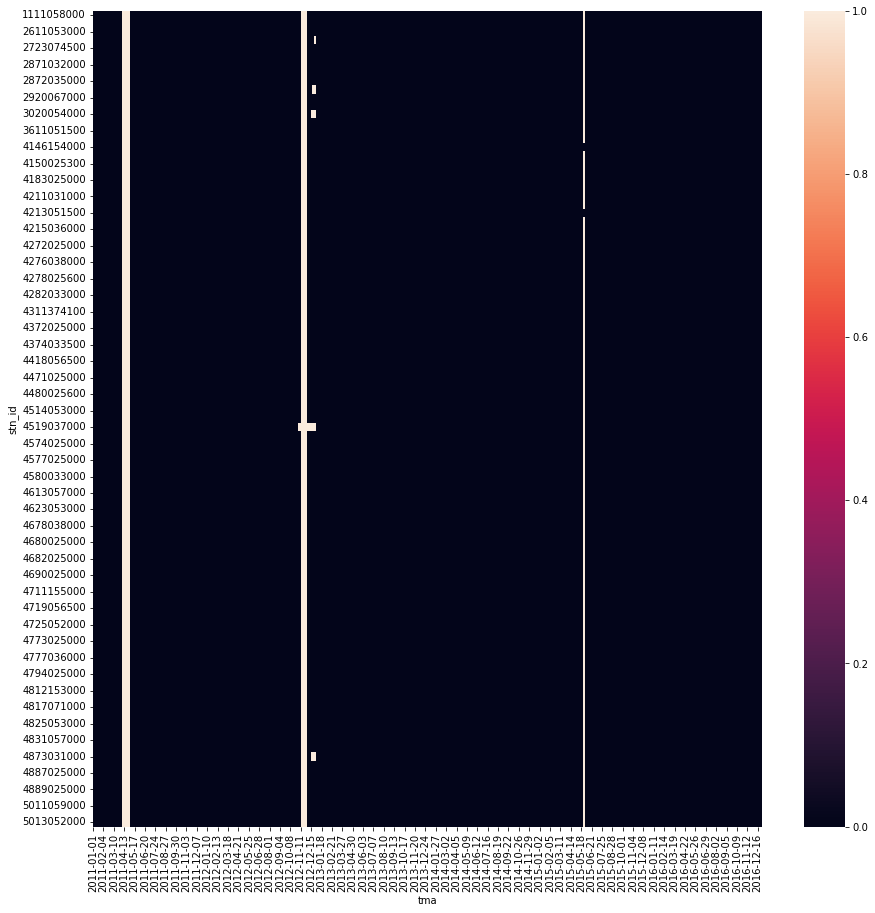

In [59]:
df = pd.read_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig")
plt.figure(figsize = (15, 15))
sns.heatmap(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()))
plt.show()

In [28]:
null_time = pd.DataFrame(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()).reset_index(drop = True).mean(), columns = ["time"])
atm = null_time.query("time == 1").index
atm = df.query("tma in @atm").index #모든 관측소 동시에 결측된 경우
stm = null_time.query("time > 0.5 and time < 1").index
stm = df[df["value"].isnull()].query("tma in @stm").index #대부분의 관측소가 결측된 경우
ntm = null_time.query("time > 0 and time < 0.5").index
ntm = df[df["value"].isnull()].query("tma in @ntm").index #몇몇 관측소만 결측된 경우

In [46]:
df.loc[atm, :]

,yyyymmdd,tma,add,address,value,stn_id,long,lat
96,20110407,2011-04-07,강원,갈말읍,NaN,4278025600,127.310431,38.144950
97,20110408,2011-04-08,강원,갈말읍,NaN,4278025600,127.310431,38.144950
98,20110409,2011-04-09,강원,갈말읍,NaN,4278025600,127.310431,38.144950
99,20110410,2011-04-10,강원,갈말읍,NaN,4278025600,127.310431,38.144950
100,20110411,2011-04-11,강원,갈말읍,NaN,4278025600,127.310431,38.144950
...,...,...,...,...,...,...,...,...
215511,20121126,2012-11-26,충북,추풍령면,NaN,4374033500,128.000875,36.211633
215512,20121127,2012-11-27,충북,추풍령면,NaN,4374033500,128.000875,36.211633
215513,20121128,2012-11-28,충북,추풍령면,NaN,4374033500,128.000875,36.211633
215514,20121129,2012-11-29,충북,추풍령면,NaN,4374033500,128.000875,36.211633


## 모든 관측소가 동시에 결측된 경우
* 시간 인덱스는 동일한 간격으로 떨어져 있고, 데이터 순서가 각 관측소가 한 덩어리로 묶여 있기 때문에 그대로 데이터 앞뒤 보간하면 될듯

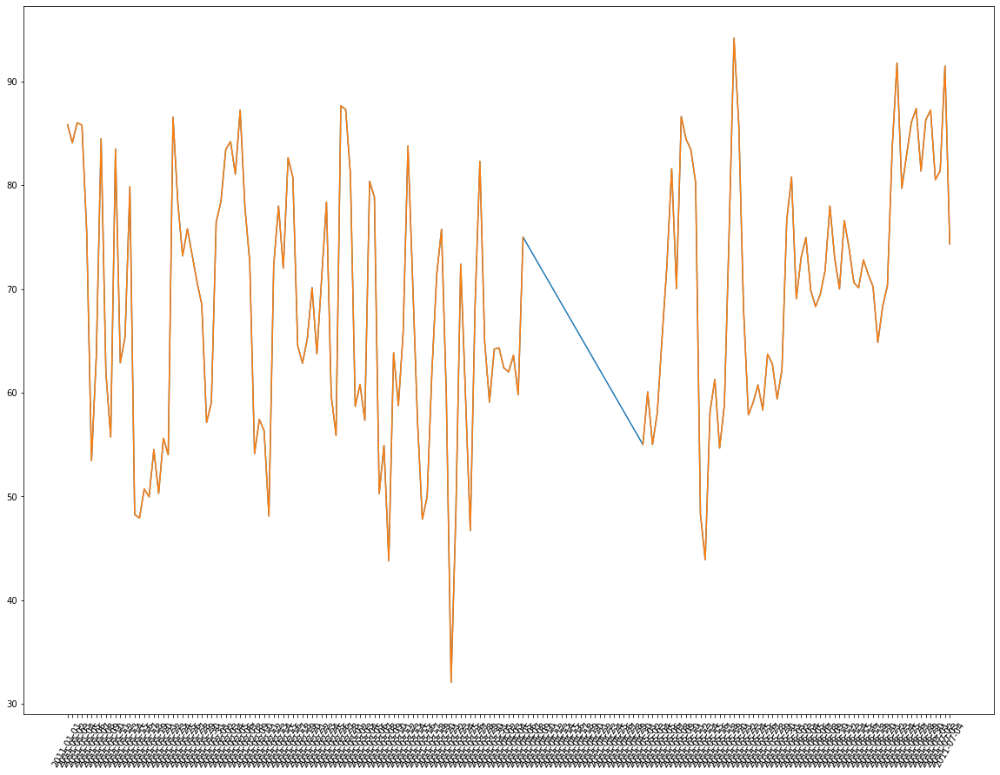

In [56]:
plt.figure(figsize = (20, 15))
plt.plot(df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["tma"], df.interpolate().query("stn_id == 4278025600 and yyyymmdd < 20110705")["value"])
plt.plot(df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["tma"], df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["value"])
plt.xticks(rotation = 60)
plt.show()

In [60]:
print(df.isnull().sum())
df.loc[atm, "value"] = df.interpolate().loc[atm, "value"].values
df.isnull().sum()

yyyymmdd       0
tma            0
add            0
address        0
value       5126
stn_id         0
long           0
lat            0
dtype: int64


yyyymmdd      0
tma           0
add           0
address       0
value       770
stn_id        0
long          0
lat           0
dtype: int64

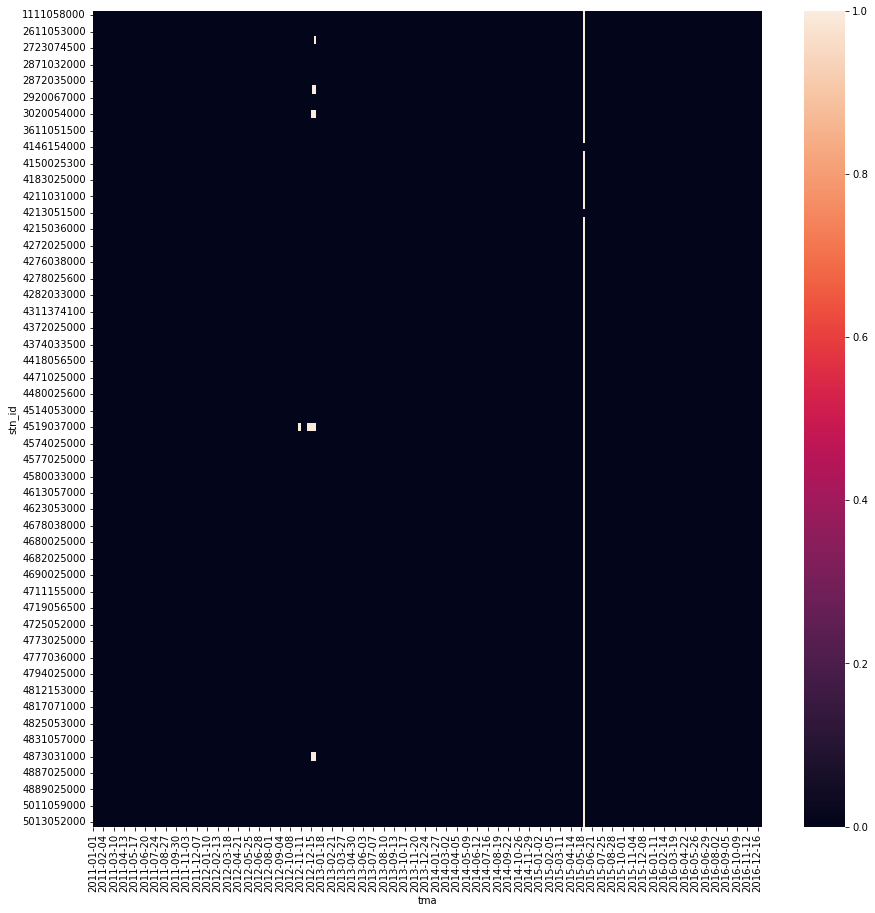

In [62]:
plt.figure(figsize = (15, 15))
sns.heatmap(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().sum()))
plt.show()

## 대부분의 관측소가 결측된 경우
* 모든 관측소가 결측된 기간의 경우와 마찬가지로 전체 보간 후 해당 인덱스만 잘라오기

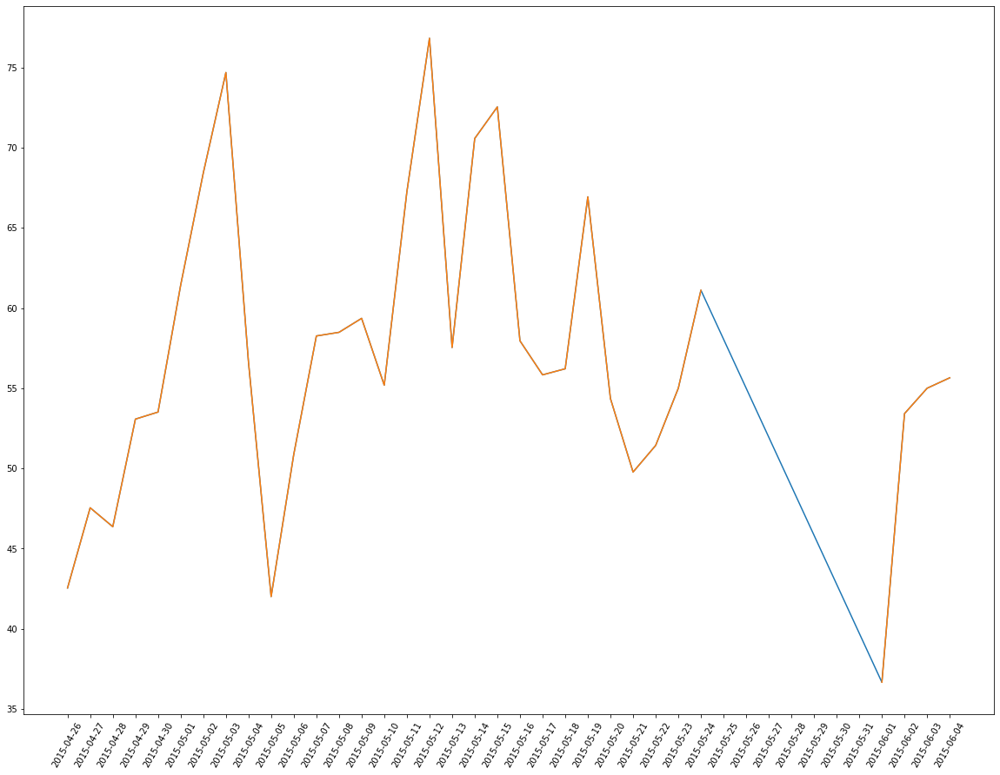

In [64]:
plt.figure(figsize = (20, 15))
plt.plot(df.query("stn_id == 4278025600 and yyyymmdd > 20150425 and yyyymmdd < 20150605")["tma"], df.interpolate().query("stn_id == 4278025600 and yyyymmdd > 20150425 and yyyymmdd < 20150605")["value"])
plt.plot(df.query("stn_id == 4278025600 and yyyymmdd > 20150425 and yyyymmdd < 20150605")["tma"], df.query("stn_id == 4278025600 and yyyymmdd > 20150425 and yyyymmdd < 20150605")["value"])
plt.xticks(rotation = 60)
plt.show()

In [65]:
print(df.isnull().sum())
df.loc[stm, "value"] = df.interpolate().loc[stm, "value"].values
df.isnull().sum()

yyyymmdd      0
tma           0
add           0
address       0
value       770
stn_id        0
long          0
lat           0
dtype: int64


yyyymmdd     0
tma          0
add          0
address      0
value       91
stn_id       0
long         0
lat          0
dtype: int64

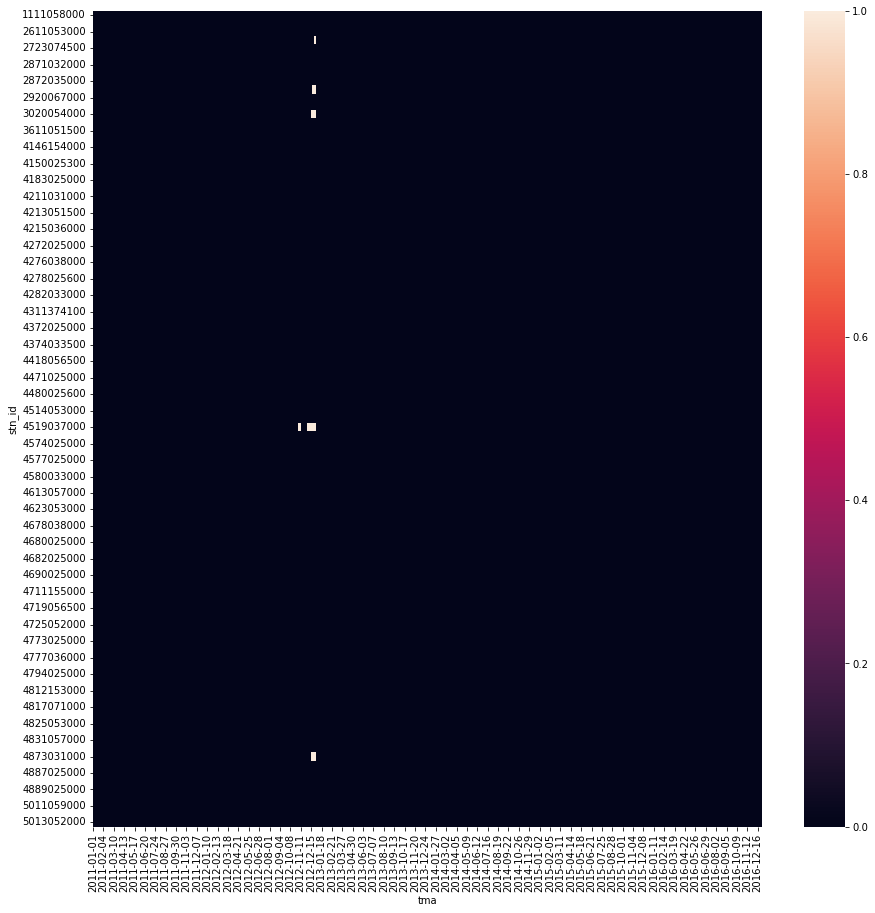

In [66]:
plt.figure(figsize = (15, 15))
sns.heatmap(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().sum()))
plt.show()

## 몇 개의 관측소만 결측된 경우
* 거리 기준으로 선형보간

In [92]:
area3 = df[["stn_id", "address", "lat", "long", "add"]].drop_duplicates().reset_index(drop = True)
s_idx = df[df["value"].isnull()]["stn_id"].unique()
for s in s_idx:
    latlon = df.query("stn_id == @s")[["lat", "long"]].drop_duplicates().values[0]
    x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
    y = 111 * np.abs(latlon[0] - area3["lat"])
    area3["distance"] = np.sqrt((x**2).squeeze() + y**2)
    #print(area3.query("distance < 50"))
    df1 = pd.merge(df, area3[["stn_id", "distance"]], on = "stn_id", how = "left")
    df1["index"] = df1.index
    df1 = df1.set_index("distance")
    ymd = df[df["value"].isnull()].query("stn_id == @s")["tma"].unique()
    for y in ymd:
        print(s, y)
        idx = df[df["value"].isnull()].query("stn_id == @s and tma == @y").index
        df.loc[idx, "value"] = df1.query("tma == @y").interpolate(method = "index").query("stn_id == @s")["value"].values[0]
df.isnull().sum()

4873031000 2012-12-16
4873031000 2012-12-17
4873031000 2012-12-18
4873031000 2012-12-19
4873031000 2012-12-20
4873031000 2012-12-21
4873031000 2012-12-22
4873031000 2012-12-23
4873031000 2012-12-24
4873031000 2012-12-25
4873031000 2012-12-26
4873031000 2012-12-27
4873031000 2012-12-28
4873031000 2012-12-29
4873031000 2012-12-30
4873031000 2012-12-31
2917060100 2012-12-18
2917060100 2012-12-19
2917060100 2012-12-20
2917060100 2012-12-21
2917060100 2012-12-22
2917060100 2012-12-23
2917060100 2012-12-24
2917060100 2012-12-25
2917060100 2012-12-26
2917060100 2012-12-27
2917060100 2012-12-28
2917060100 2012-12-29
2917060100 2012-12-30
2917060100 2012-12-31
2714059000 2012-12-25
2714059000 2012-12-26
2714059000 2012-12-27
2714059000 2012-12-28
2714059000 2012-12-29
2714059000 2012-12-30
2714059000 2012-12-31
3020054000 2012-12-16
3020054000 2012-12-17
3020054000 2012-12-18
3020054000 2012-12-19
3020054000 2012-12-20
3020054000 2012-12-21
3020054000 2012-12-22
3020054000 2012-12-23
3020054000

yyyymmdd    0
tma         0
add         0
address     0
value       0
stn_id      0
long        0
lat         0
dtype: int64

In [93]:
df1 = pd.read_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig")

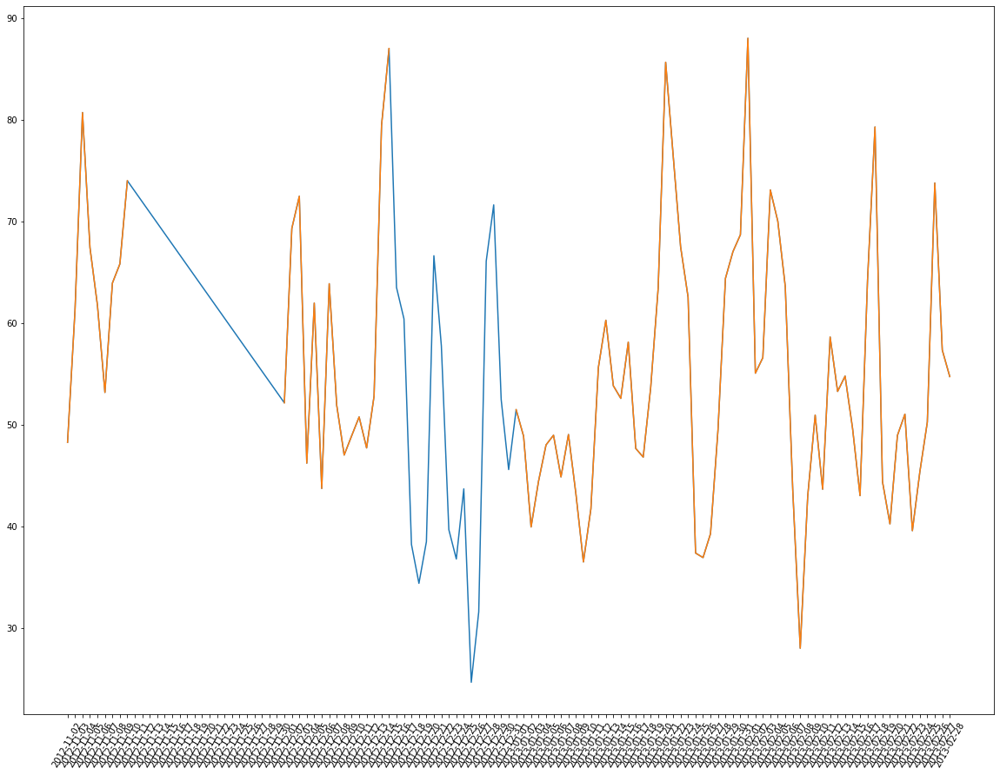

In [105]:
plt.figure(figsize = (20, 15))
plt.plot(df[df["stn_id"] == 4873031000].query("yyyymmdd > 20121101 and yyyymmdd < 20130301")["tma"].values, df[df["stn_id"] == 4873031000].query("yyyymmdd > 20121101 and yyyymmdd < 20130301")["value"].values)
plt.plot(df1[df1["stn_id"] == 4873031000].query("yyyymmdd > 20121101 and yyyymmdd < 20130301")["tma"].values, df1[df1["stn_id"] == 4873031000].query("yyyymmdd > 20121101 and yyyymmdd < 20130301")["value"].values)
plt.xticks(rotation = 60)
plt.show()

In [106]:
df.isnull().sum()

yyyymmdd    0
tma         0
add         0
address     0
value       0
stn_id      0
long        0
lat         0
dtype: int64

In [107]:
df.to_csv("final_fore_rhm_0802_lin.csv", encoding = "utf-8-sig", index = False)

# Cubic Interpolation

In [2]:
df = pd.read_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig")
null_time = pd.DataFrame(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()).reset_index(drop = True).mean(), columns = ["time"])
atm = null_time.query("time == 1").index
atm = df.query("tma in @atm").index #모든 관측소 동시에 결측된 경우
stm = null_time.query("time > 0.5 and time < 1").index
stm = df[df["value"].isnull()].query("tma in @stm").index #대부분의 관측소가 결측된 경우
ntm = null_time.query("time > 0 and time < 0.5").index
ntm = df[df["value"].isnull()].query("tma in @ntm").index #몇몇 관측소만 결측된 경우

2


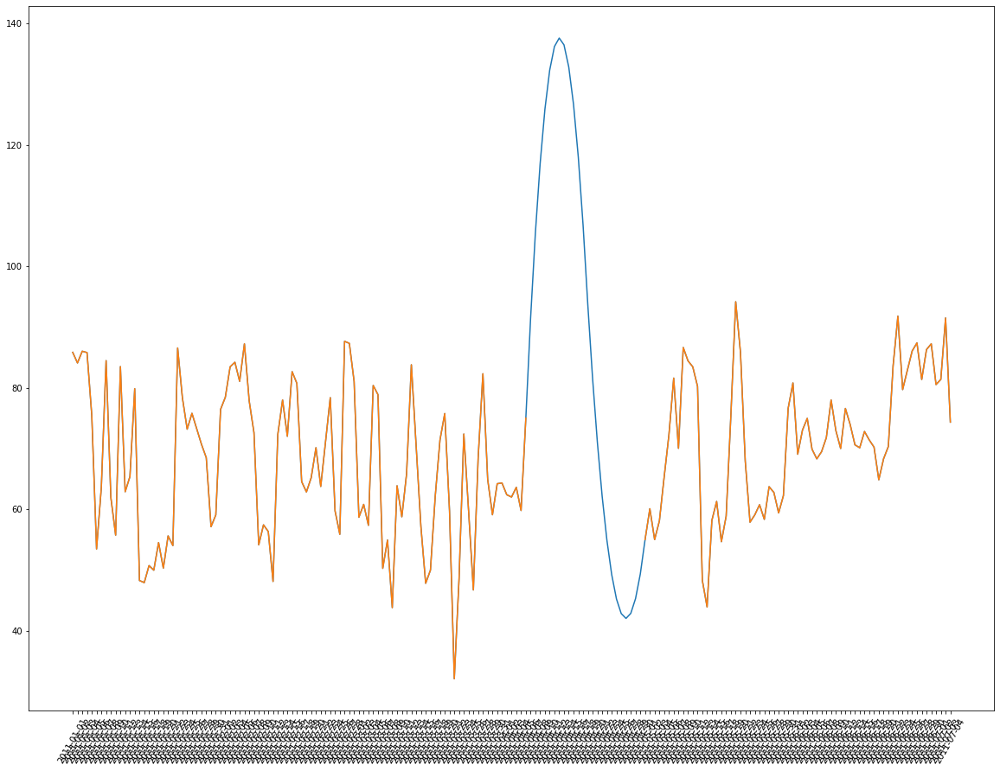

3


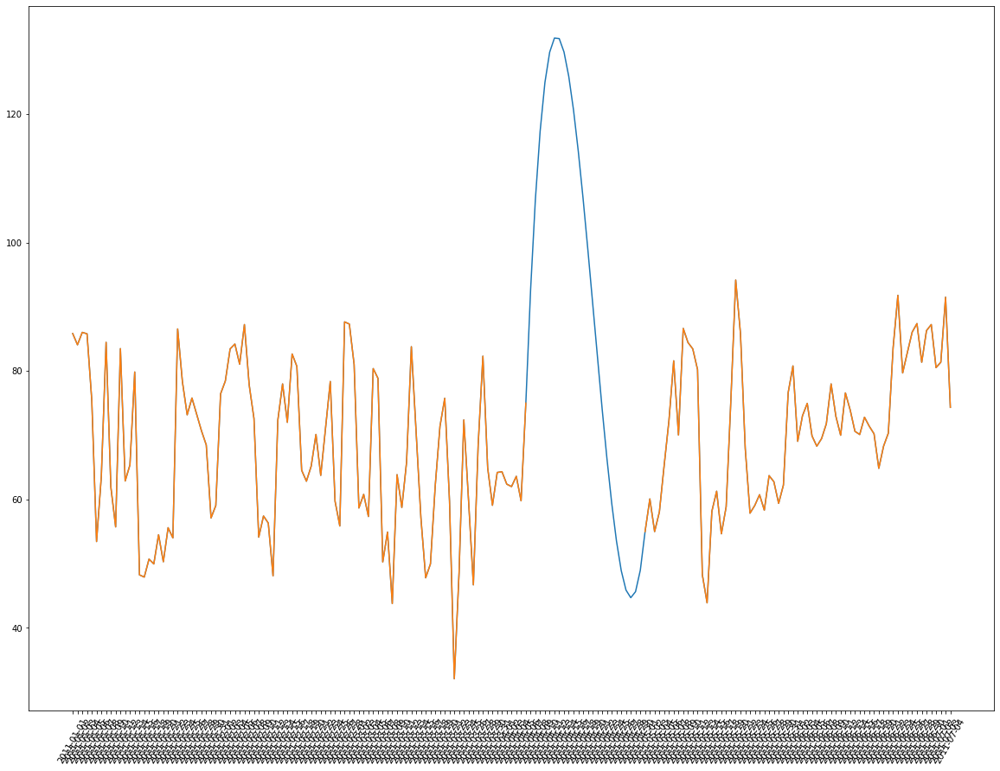

In [6]:
for i in range(2, 4):
    print(i)
    plt.figure(figsize = (20, 15))
    plt.plot(df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["tma"], df.interpolate(method = "polynomial", order = i).query("stn_id == 4278025600 and yyyymmdd < 20110705")["value"])
    plt.plot(df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["tma"], df.query("stn_id == 4278025600 and yyyymmdd < 20110705")["value"])
    plt.xticks(rotation = 60)
    plt.show()
    #물리적 상한을 너무 넘겨서 폐기

# 예보 결측치 관측치로 채우기

In [122]:
import os
import unicodedata
list = [x for x in os.listdir("/Users/seong-yeseul/Downloads/fore") if x.split(".")[1] == "csv"]
final = pd.DataFrame()
for l in list:
    final = pd.concat([final, pd.read_csv("/Users/seong-yeseul/Downloads/fore/" + l, encoding = "cp949")], axis = 0).reset_index(drop = True)
final.columns = ["stn_id", "name", "tma", "min_rhm", "avg_rhm"]
final["yyyymmdd"] = final["tma"].apply(lambda x: int(str(x).replace("-", "").strip()))
final["name"] = final["name"].apply(lambda x: unicodedata.normalize("NFC", x))
final = pd.merge(final, pd.read_csv("mapping_0720.csv", encoding = "utf-8-sig"), on = "stn_id", how = "left")
final = final.rename({"name_x" : "name"}, axis = 1).drop("name_y", axis = 1)
final

,stn_id,name,tma,min_rhm,avg_rhm,yyyymmdd,address,lat,long,add
0,90,속초,2016-01-01,30.0,44.9,20160101,강원도 고성군 토성면 봉포리,38.250875,128.564715,강원
1,90,속초,2016-01-02,38.0,50.4,20160102,강원도 고성군 토성면 봉포리,38.250875,128.564715,강원
2,90,속초,2016-01-03,53.0,80.0,20160103,강원도 고성군 토성면 봉포리,38.250875,128.564715,강원
3,90,속초,2016-01-04,13.0,32.6,20160104,강원도 고성군 토성면 봉포리,38.250875,128.564715,강원
4,90,속초,2016-01-05,9.0,16.8,20160105,강원도 고성군 토성면 봉포리,38.250875,128.564715,강원
...,...,...,...,...,...,...,...,...,...,...
204068,295,남해,2011-12-27,17.0,33.9,20111227,경상남도 남해군 이동면 다정리,34.816610,127.926405,경남
204069,295,남해,2011-12-28,24.0,38.6,20111228,경상남도 남해군 이동면 다정리,34.816610,127.926405,경남
204070,295,남해,2011-12-29,29.0,51.0,20111229,경상남도 남해군 이동면 다정리,34.816610,127.926405,경남
204071,295,남해,2011-12-30,31.0,52.8,20111230,경상남도 남해군 이동면 다정리,34.816610,127.926405,경남


In [160]:
area3 = final[["add", "address", "stn_id", "name", "lat", "long"]].drop_duplicates().copy()
df1 = pd.read_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig")
for a in df["address"].unique():
    #display(df.query("address == @a").iloc[0, :])
    latlon = df.query("address == @a")[["lat", "long"]].drop_duplicates().values[0]
    x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
    y = 111 * np.abs(latlon[0] - area3["lat"])
    area3["distance"] = np.sqrt((x**2).squeeze() + y**2)
    s = area3[area3["distance"] == np.min(area3["distance"])]["stn_id"].values[0]
    idx = df1[df1["value"].isnull()].query("address == @a").index
    ymd = df1.loc[idx, "yyyymmdd"].values
    #display(final.query("stn_id == @s and yyyymmdd in @ymd"))
    dd = pd.merge(df1.loc[idx, :], final.query("stn_id == @s and yyyymmdd in @ymd")[["yyyymmdd", "avg_rhm"]], how = "left", on = "yyyymmdd")
    ymd = dd["yyyymmdd"].to_list()
    idx = df1[df1["value"].isnull()].query("address == @a and yyyymmdd in @ymd").index
    print(df1.loc[idx, :])
    print(np.mean(dd["yyyymmdd"].values == df1.loc[idx, "yyyymmdd"].values))
    df1.loc[idx, "value"] = dd["avg_rhm"].values
    #print(area3.query("distance < 50"))

      yyyymmdd         tma add address  value      stn_id        long  \
96    20110407  2011-04-07  강원     갈말읍    NaN  4278025600  127.310431   
97    20110408  2011-04-08  강원     갈말읍    NaN  4278025600  127.310431   
98    20110409  2011-04-09  강원     갈말읍    NaN  4278025600  127.310431   
99    20110410  2011-04-10  강원     갈말읍    NaN  4278025600  127.310431   
100   20110411  2011-04-11  강원     갈말읍    NaN  4278025600  127.310431   
101   20110412  2011-04-12  강원     갈말읍    NaN  4278025600  127.310431   
102   20110413  2011-04-13  강원     갈말읍    NaN  4278025600  127.310431   
103   20110414  2011-04-14  강원     갈말읍    NaN  4278025600  127.310431   
104   20110415  2011-04-15  강원     갈말읍    NaN  4278025600  127.310431   
105   20110416  2011-04-16  강원     갈말읍    NaN  4278025600  127.310431   
106   20110417  2011-04-17  강원     갈말읍    NaN  4278025600  127.310431   
107   20110418  2011-04-18  강원     갈말읍    NaN  4278025600  127.310431   
108   20110419  2011-04-19  강원     갈말읍    NaN  4278

In [161]:
df1.isnull().sum()

yyyymmdd      0
tma           0
add           0
address       0
value       191
stn_id        0
long          0
lat           0
dtype: int64

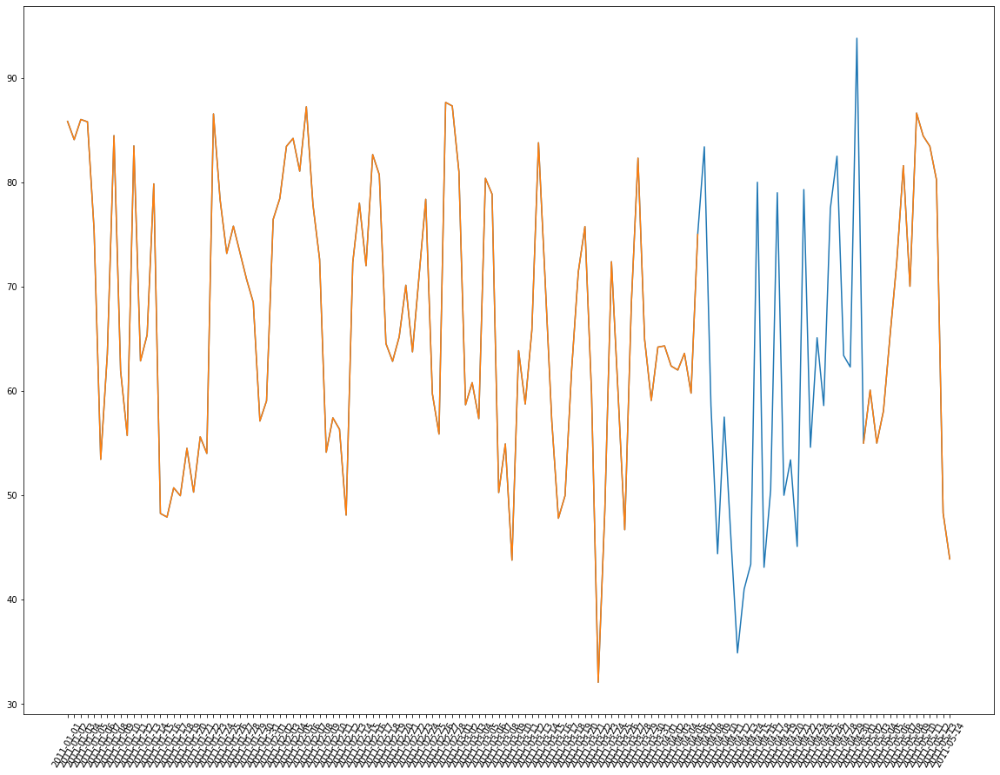

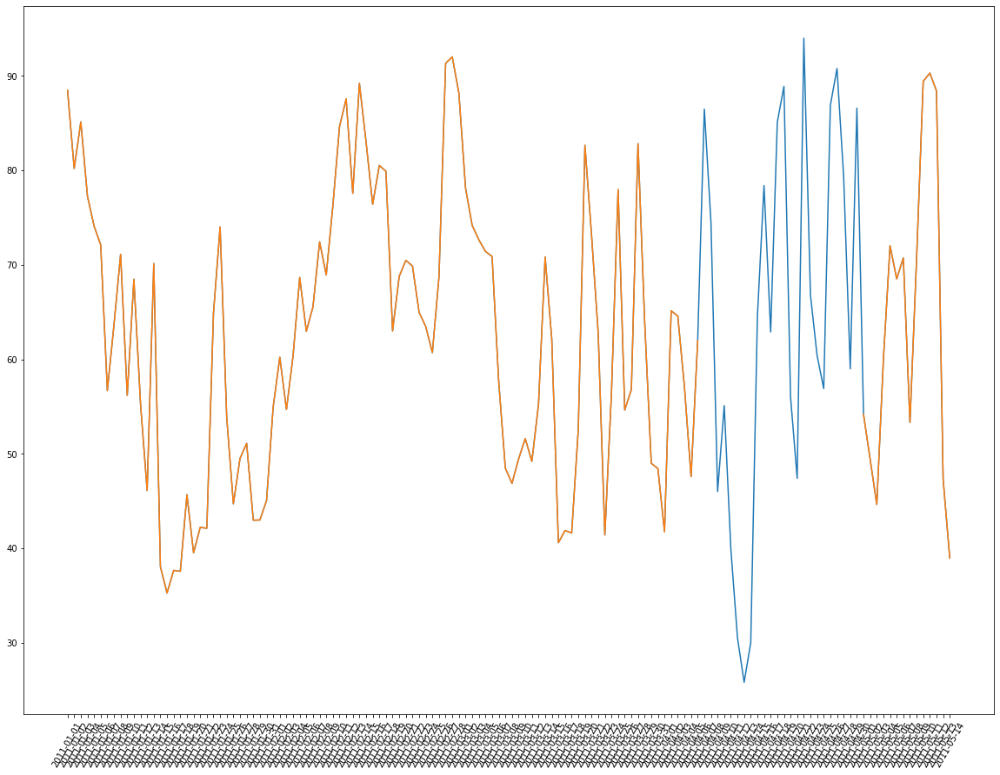

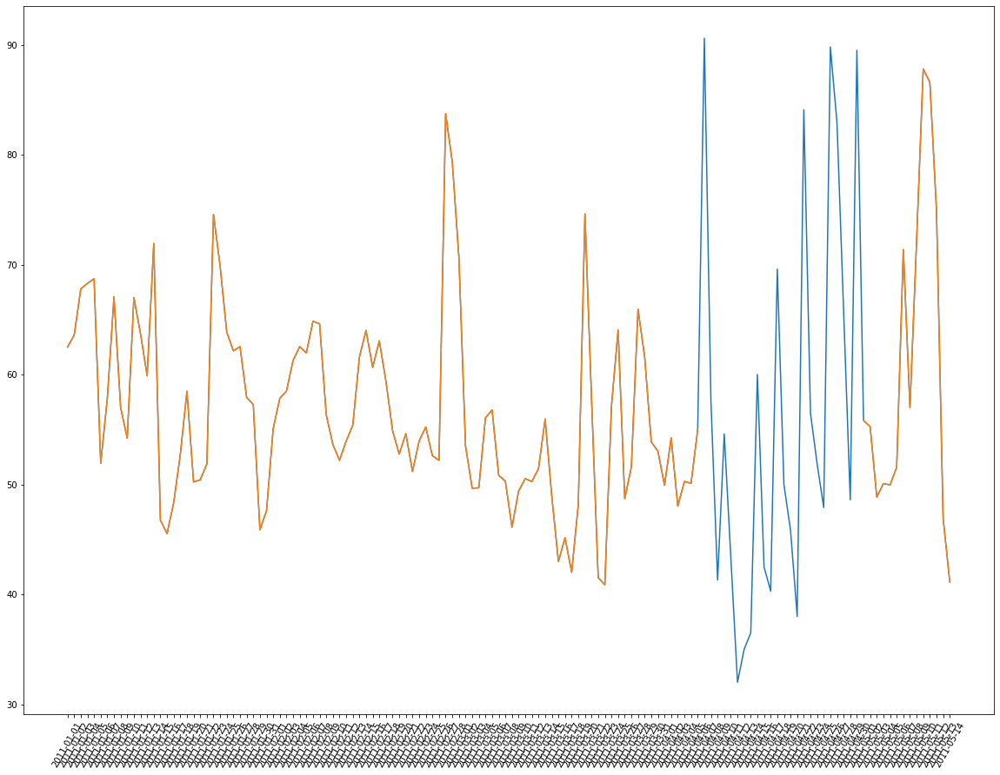

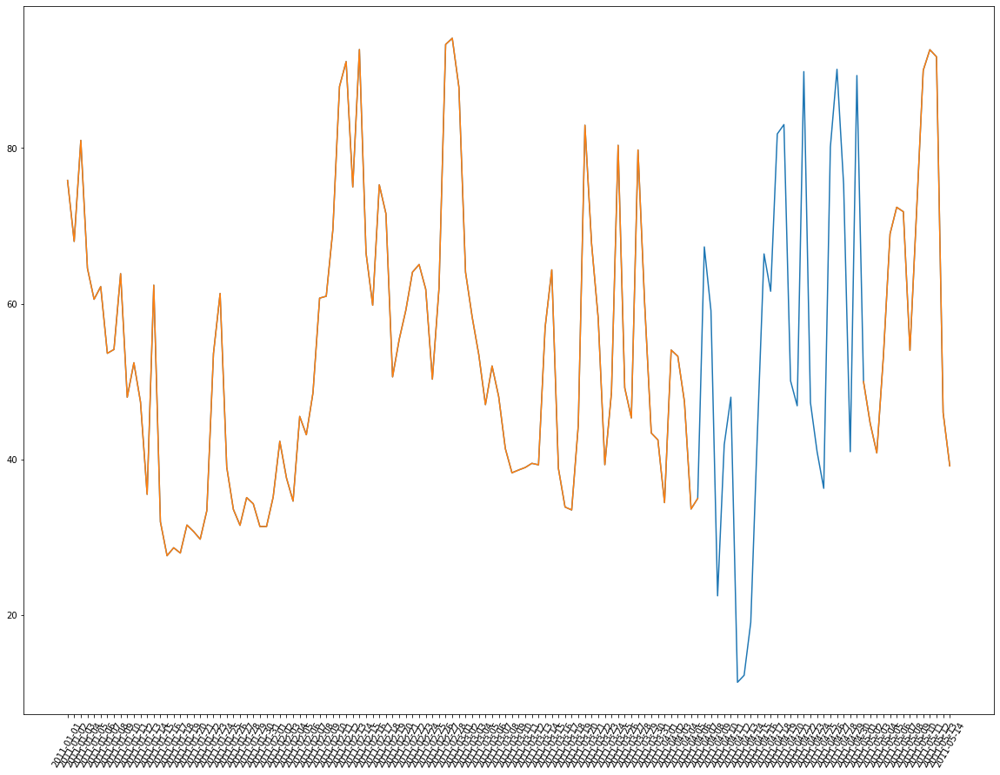

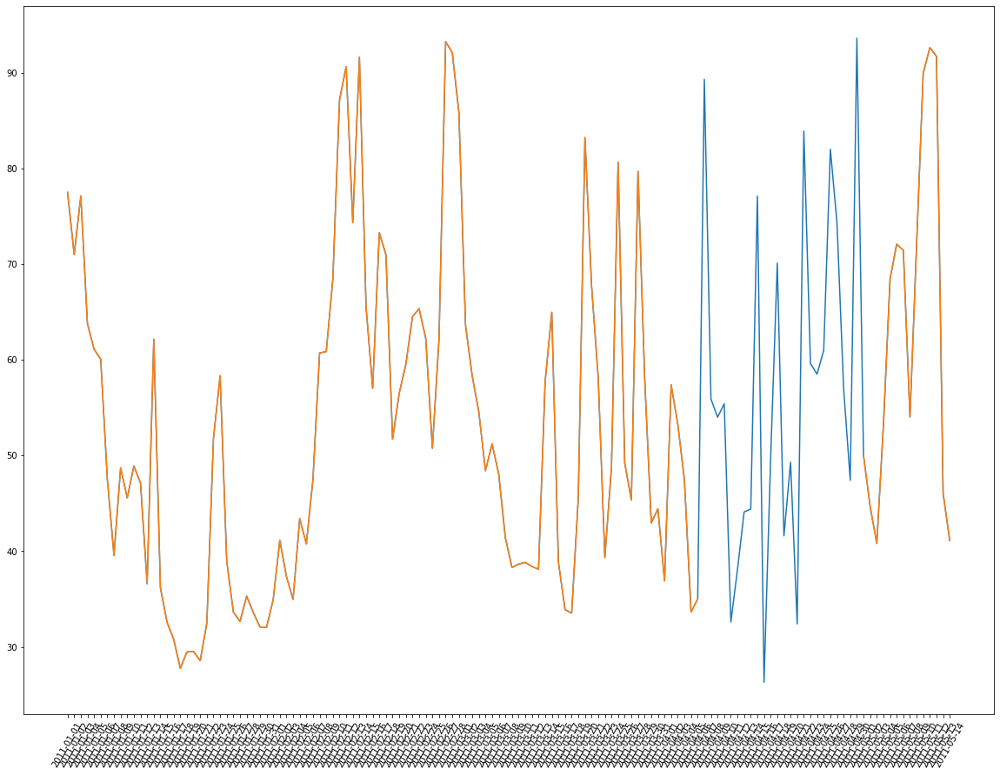

...

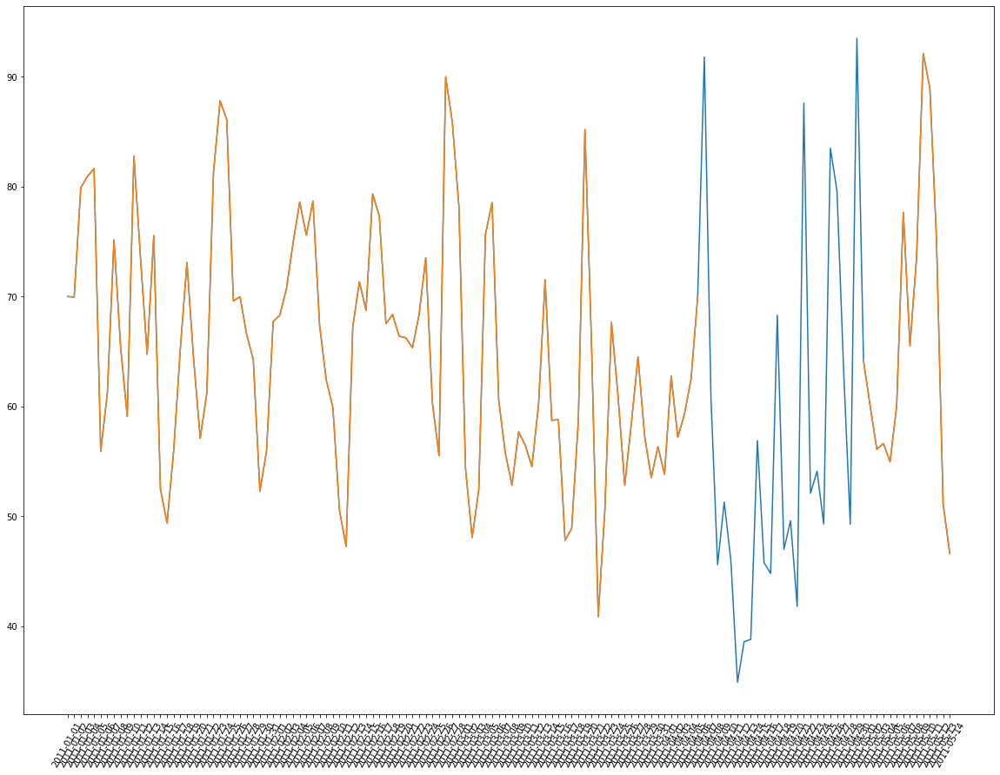

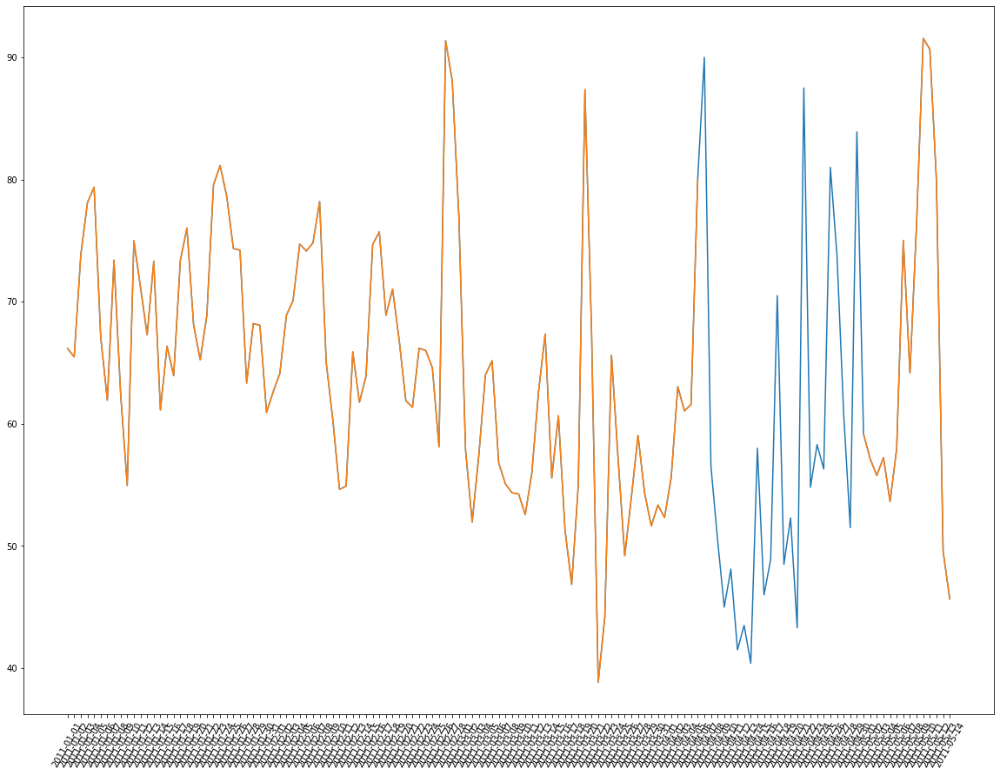

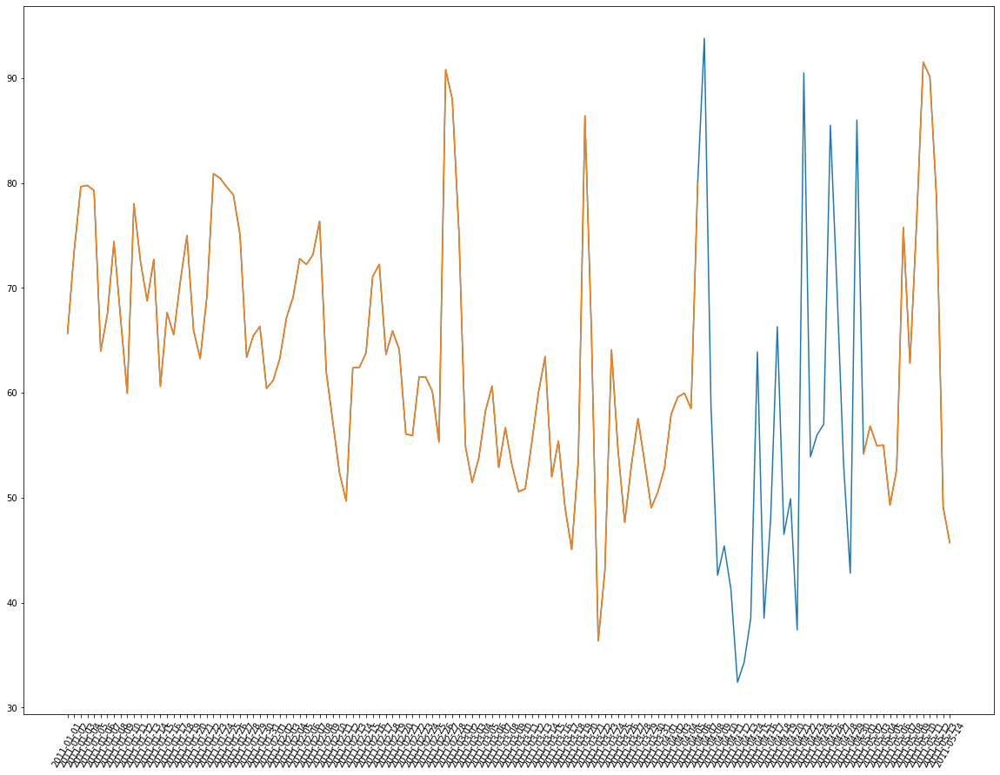

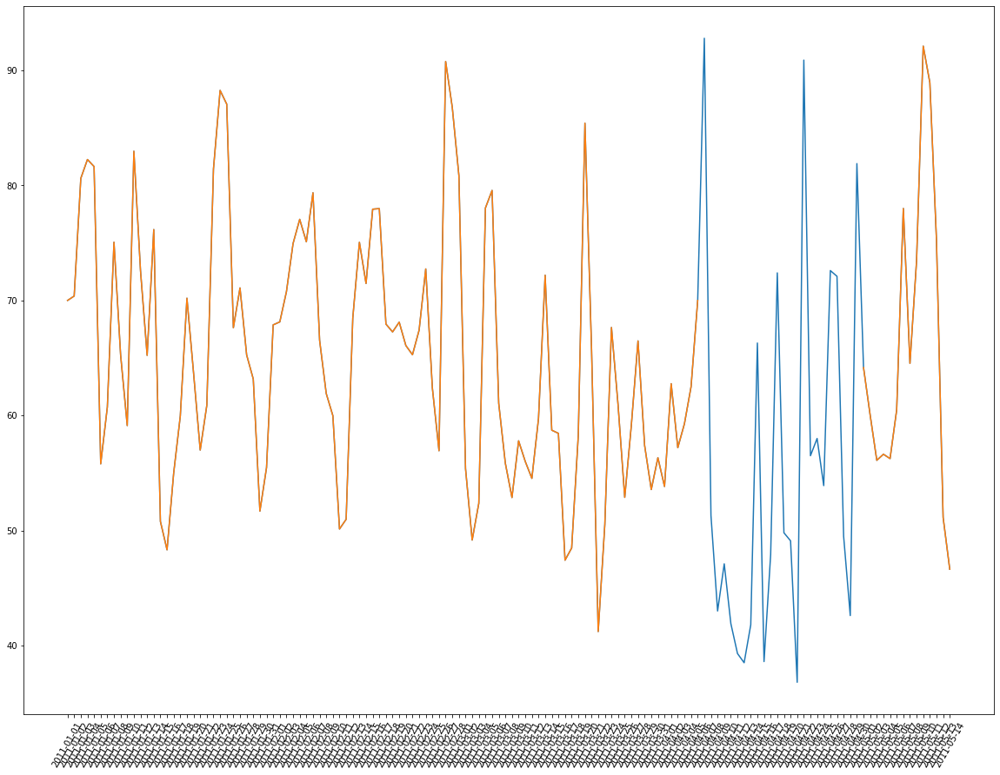

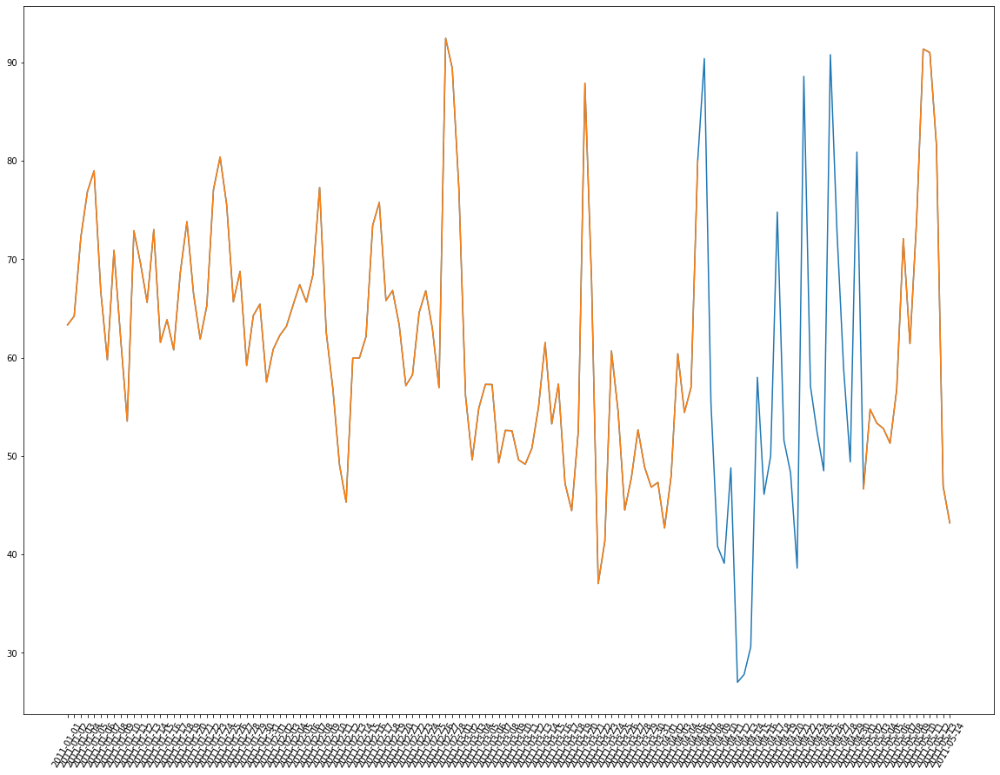

In [163]:
df = pd.read_csv("null_fore_rhm_0801.csv", encoding = "utf-8-sig")
for s in df[df["value"].isnull()]["stn_id"].unique():
    plt.figure(figsize = (20, 15))
    plt.plot(df1[df1["stn_id"] == s].query("yyyymmdd < 20110515")["tma"].values, df1[df1["stn_id"] == s].query("yyyymmdd < 20110515")["value"].values)
    plt.plot(df[df["stn_id"] == s].query("yyyymmdd < 20110515")["tma"].values, df[df["stn_id"] == s].query("yyyymmdd < 20110515")["value"].values)
    plt.xticks(rotation = 60)
    plt.show()

<AxesSubplot:xlabel='tma', ylabel='address'>

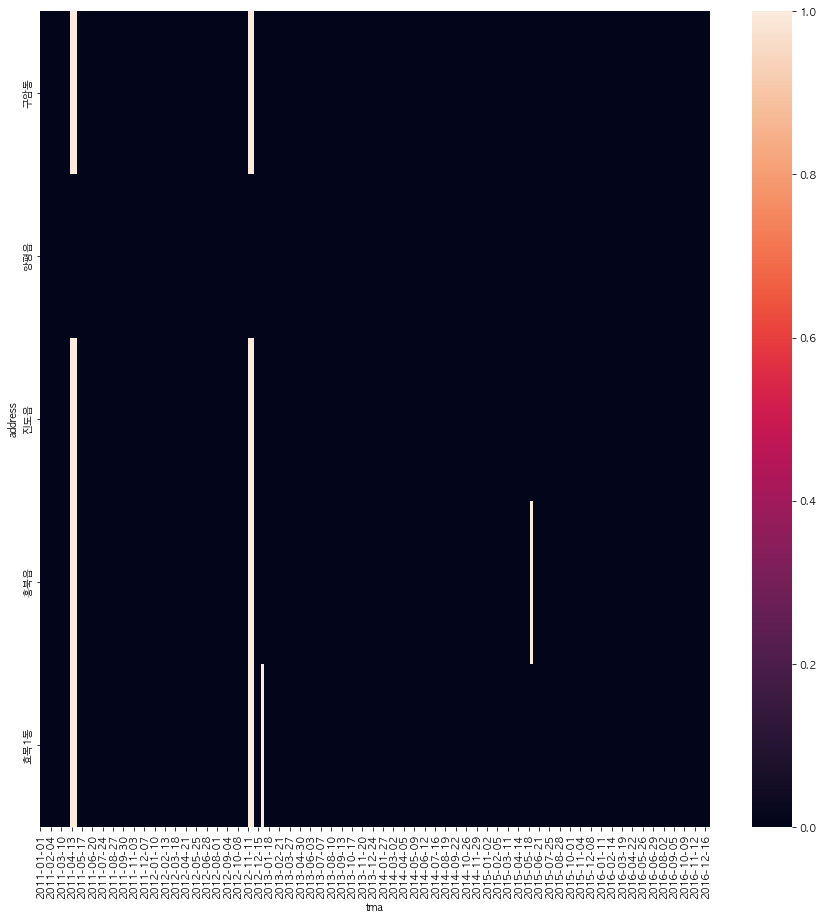

In [167]:
plt.figure(figsize = (15, 15))
s = df1[df1["value"].isnull()]["stn_id"].unique()
plt.rc("font", family = "AppleGothic")
sns.heatmap(df1.query("stn_id in @s").pivot_table(index = "address", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()))

<AxesSubplot:xlabel='tma', ylabel='address'>

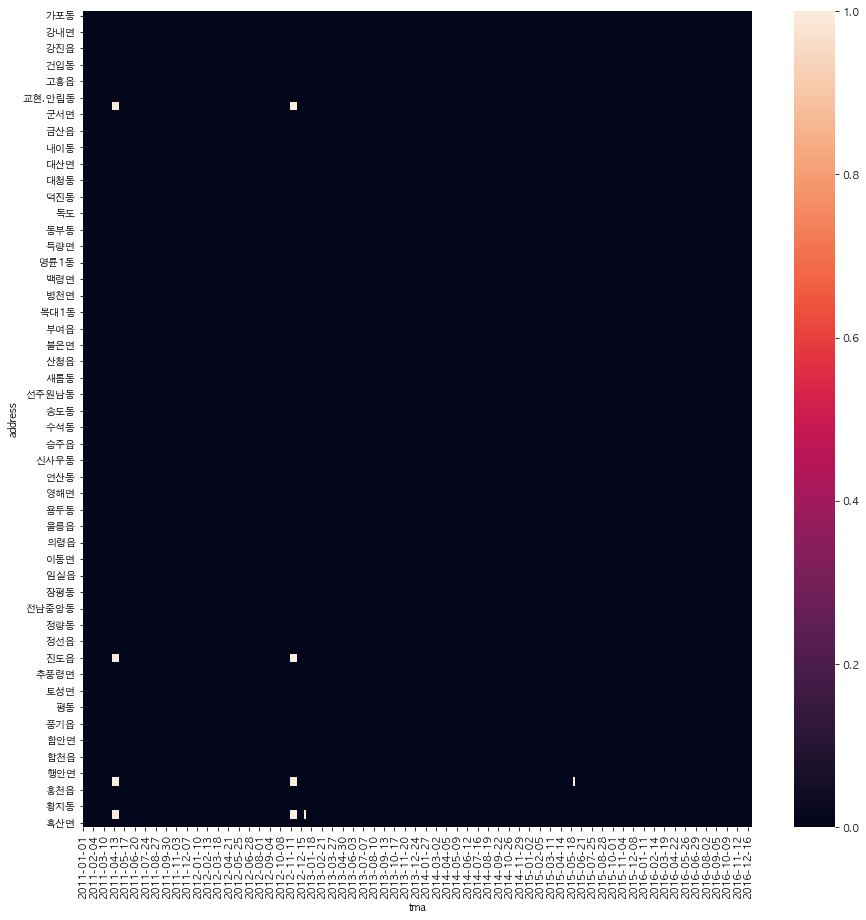

In [168]:
plt.figure(figsize = (15, 15))
sns.heatmap(df1.pivot_table(index = "address", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()))

In [169]:
df1.to_csv("fore_ing.csv", encoding = "utf-8-sig", index = False)
del df1
df = pd.read_csv("fore_ing.csv", encoding = "utf-8-sig")
df.isnull().sum()

yyyymmdd      0
tma           0
add           0
address       0
value       191
stn_id        0
long          0
lat           0
dtype: int64

In [170]:
area3 = df[["stn_id", "address", "lat", "long", "add"]].drop_duplicates().reset_index(drop = True)
s_idx = df[df["value"].isnull()]["stn_id"].unique()
for s in s_idx:
    latlon = df.query("stn_id == @s")[["lat", "long"]].drop_duplicates().values[0]
    x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
    y = 111 * np.abs(latlon[0] - area3["lat"])
    area3["distance"] = np.sqrt((x**2).squeeze() + y**2)
    #print(area3.query("distance < 50"))
    df1 = pd.merge(df, area3[["stn_id", "distance"]], on = "stn_id", how = "left")
    df1["index"] = df1.index
    df1 = df1.set_index("distance")
    ymd = df[df["value"].isnull()].query("stn_id == @s")["tma"].unique()
    for y in ymd:
        print(s, y)
        idx = df[df["value"].isnull()].query("stn_id == @s and tma == @y").index
        df.loc[idx, "value"] = df1.query("tma == @y").interpolate(method = "index").query("stn_id == @s")["value"].values[0]
df.isnull().sum()

4183025000 2011-04-30
2714059000 2011-04-07
2714059000 2011-04-08
2714059000 2011-04-09
2714059000 2011-04-10
2714059000 2011-04-11
2714059000 2011-04-12
2714059000 2011-04-13
2714059000 2011-04-14
2714059000 2011-04-15
2714059000 2011-04-16
2714059000 2011-04-17
2714059000 2011-04-18
2714059000 2011-04-19
2714059000 2011-04-20
2714059000 2011-04-21
2714059000 2011-04-22
2714059000 2011-04-23
2714059000 2011-04-24
2714059000 2011-04-25
2714059000 2011-04-26
2714059000 2011-04-27
2714059000 2011-04-28
2714059000 2011-04-29
2714059000 2011-04-30
2714059000 2012-11-11
2714059000 2012-11-12
2714059000 2012-11-13
2714059000 2012-11-14
2714059000 2012-11-15
2714059000 2012-11-16
2714059000 2012-11-17
2714059000 2012-11-18
2714059000 2012-11-19
2714059000 2012-11-20
2714059000 2012-11-21
2714059000 2012-11-22
2714059000 2012-11-23
2714059000 2012-11-24
2714059000 2012-11-25
2714059000 2012-11-26
2714059000 2012-11-27
2714059000 2012-11-28
2714059000 2012-11-29
2714059000 2012-11-30
2714059000

yyyymmdd    0
tma         0
add         0
address     0
value       0
stn_id      0
long        0
lat         0
dtype: int64

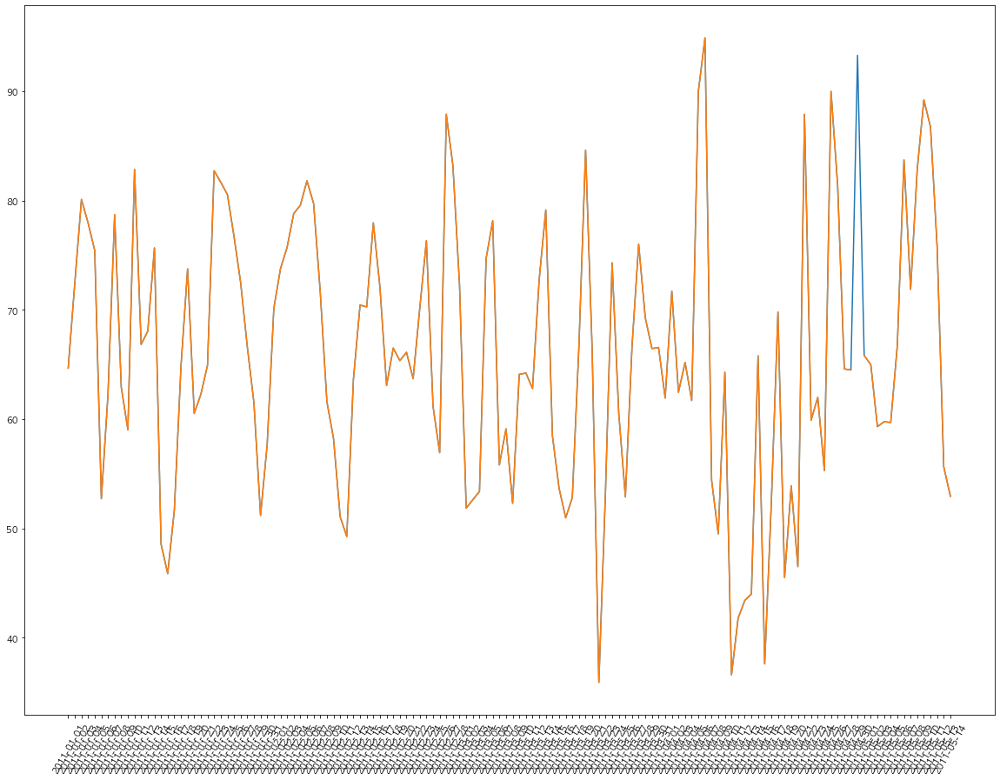

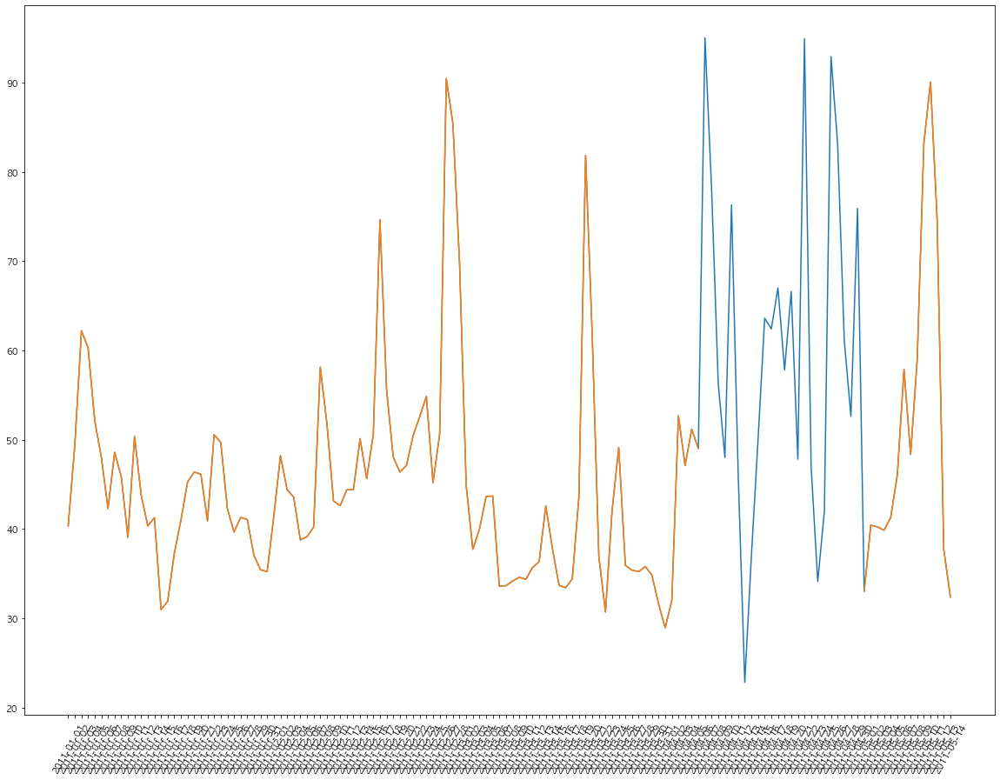

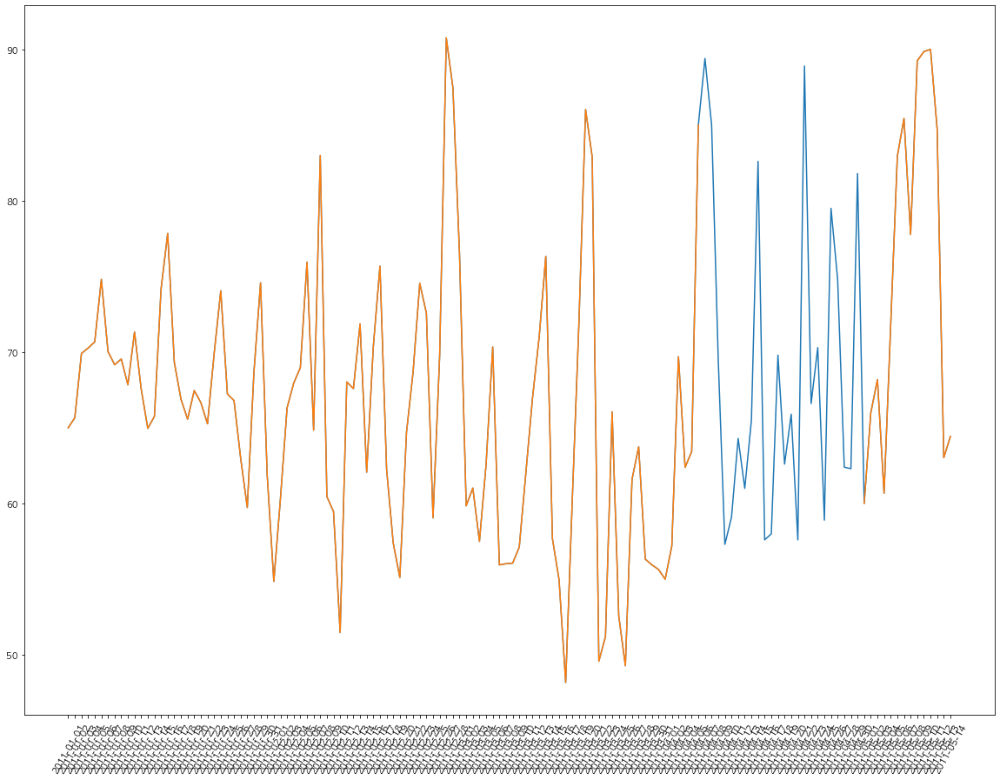

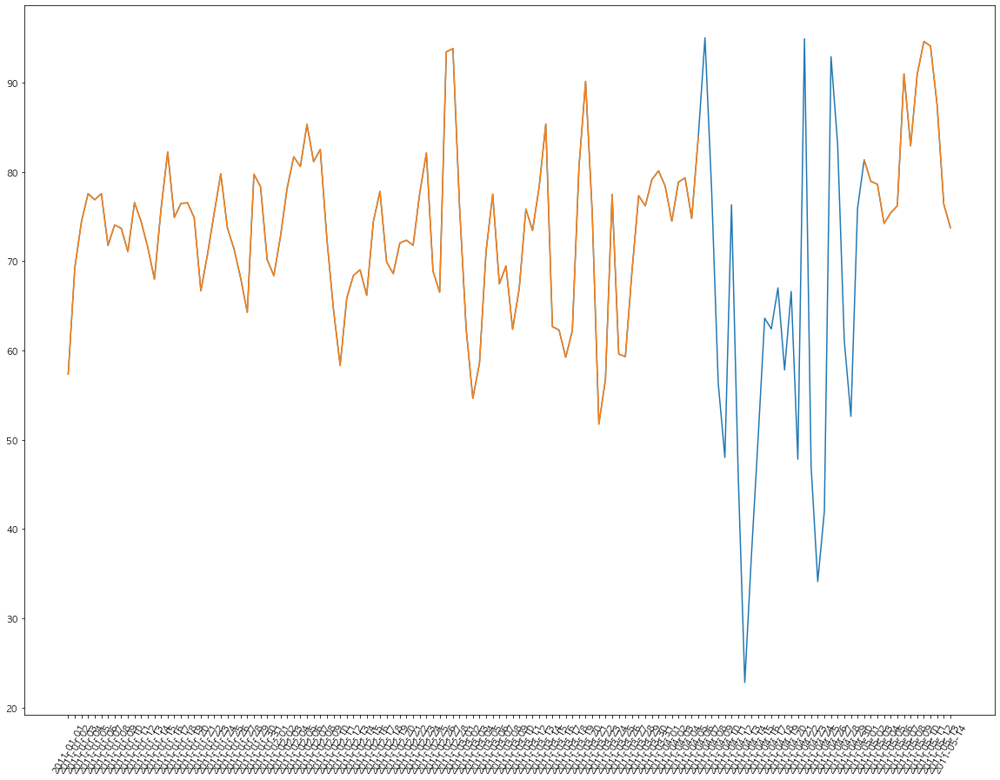

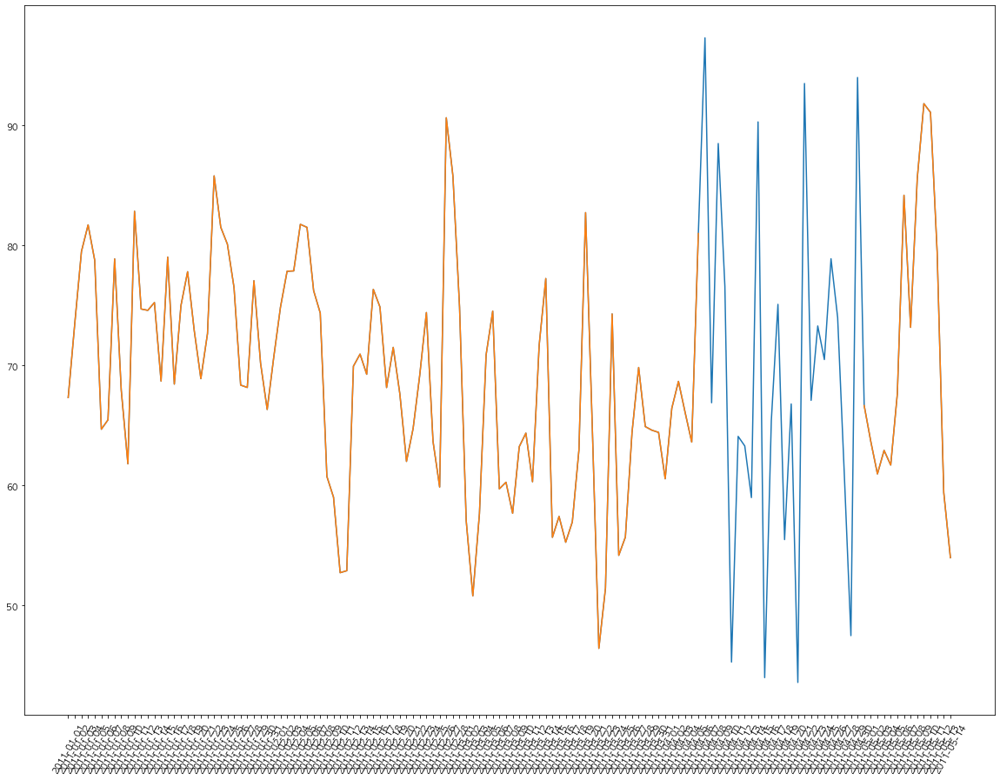

In [172]:
df1 = pd.read_csv("fore_ing.csv", encoding = "utf-8-sig")
for s in df1[df1["value"].isnull()]["stn_id"].unique():
    plt.figure(figsize = (20, 15))
    plt.plot(df[df["stn_id"] == s].query("yyyymmdd < 20110515")["tma"].values, df[df["stn_id"] == s].query("yyyymmdd < 20110515")["value"].values)
    plt.plot(df1[df1["stn_id"] == s].query("yyyymmdd < 20110515")["tma"].values, df1[df1["stn_id"] == s].query("yyyymmdd < 20110515")["value"].values)
    plt.xticks(rotation = 60)
    plt.show()

In [173]:
df.to_csv("final_fore_rhm_0802_asos.csv", encoding = "utf-8-sig", index = False)

# 참조시계열 인덱스 기준
* 위 방법은 언제까지나 인근 관측소의 시계열 데이터가 존재할 때 주변 값으로 어떻게 결측을 채울지에 대한 방법
* 따라서 전체 지역이 통으로 결측인 기존 데이터에 적용하기보다, 관측 데이터로 1차처리 + 남은 부분들에 대해 2차적으로 진행
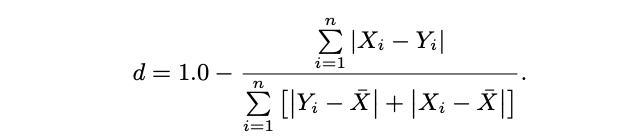

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

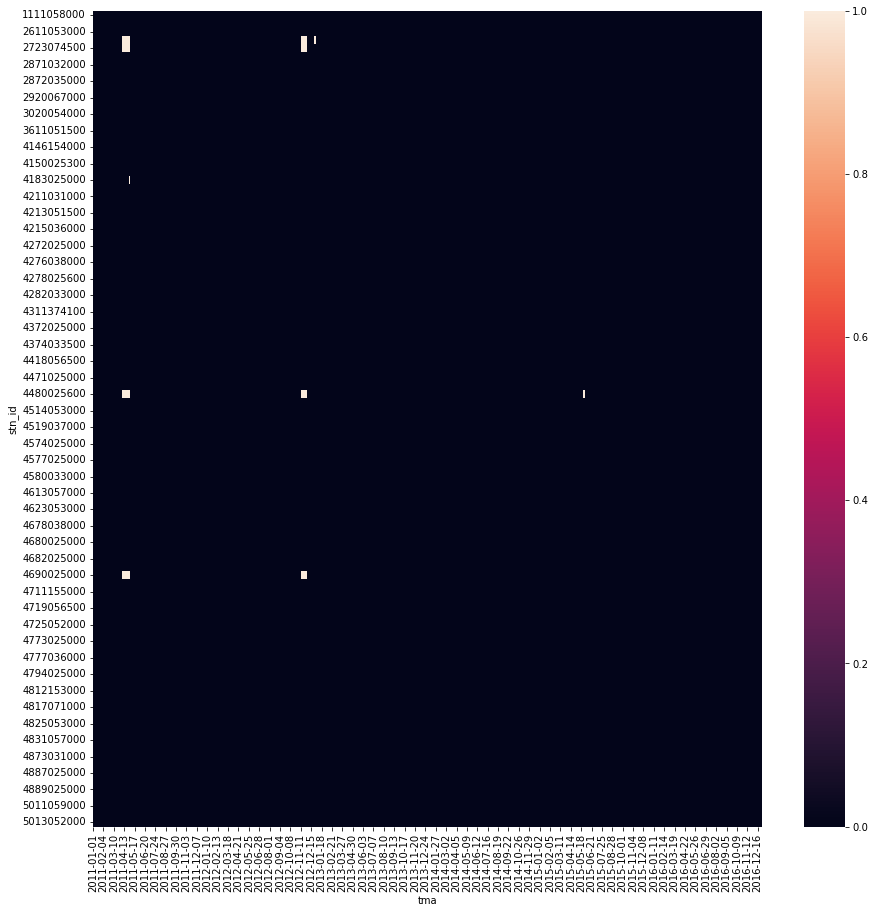

In [4]:
df = pd.read_csv("fore_ing.csv", encoding = "utf-8-sig")
plt.figure(figsize = (15, 15))
sns.heatmap(df.pivot_table(index = "stn_id", columns = "tma", values = "value", aggfunc = lambda x: x.isnull().mean()))
plt.show()

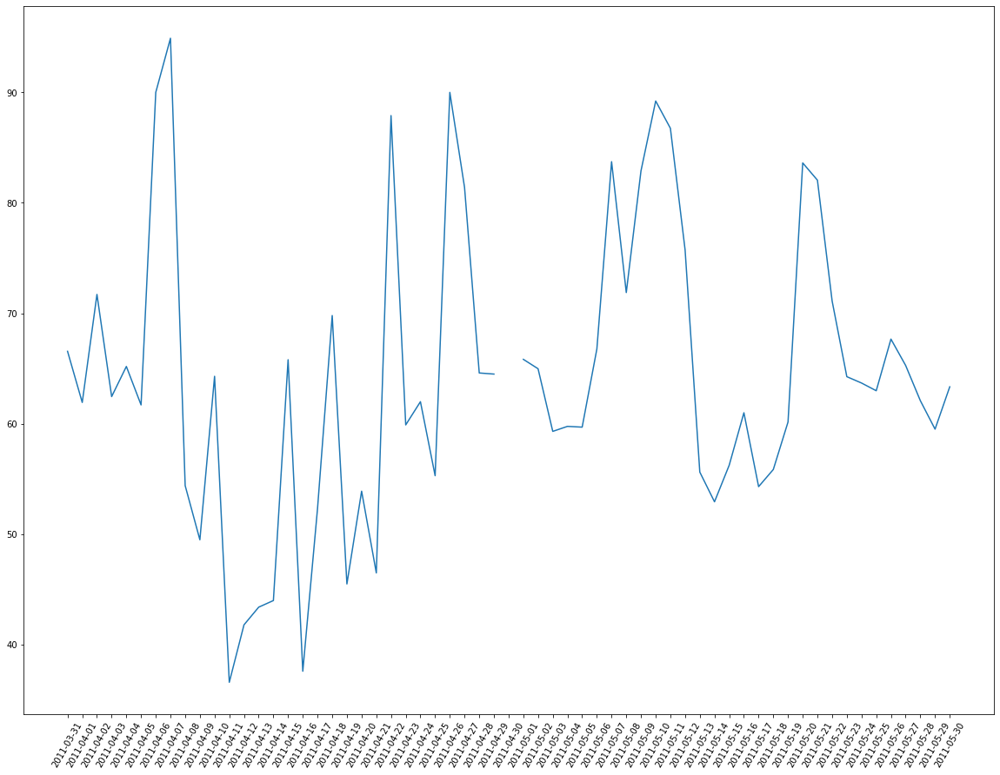

In [27]:
# 양평읍 4183025000 : 20110430
plt.figure(figsize = (20, 15))
plt.plot(df[df["stn_id"] == 4183025000].query("yyyymmdd > 20110330 and yyyymmdd < 20110531")["tma"], df[df["stn_id"] == 4183025000].query("yyyymmdd > 20110330 and yyyymmdd < 20110531")["value"])
plt.xticks(rotation = 60)
plt.show()

In [17]:
df.isnull().sum()

yyyymmdd      0
tma           0
add           0
address       0
value       191
stn_id        0
long          0
lat           0
dtype: int64

In [54]:
def dateidx(df):
    index = pd.DataFrame()
    for s in df[df["value"].isnull()]["stn_id"].unique():
        #print(s, df[df["stn_id"] == s]["address"].unique())
        ymd = df[df["value"].isnull()].query("stn_id == @s")["yyyymmdd"].unique()
        if len(ymd) == 1:
            #print(ymd)
            idx = pd.DataFrame([[s, ymd[0], ymd[0]]], columns = ["stn_id", "start", "end"])
            index = pd.concat([index, idx], axis = 0).reset_index(drop = True)
        else:
            for i in range(len(ymd)):
                if i == 0:
                    idx = [s]
                    #print("Start : ", ymd[i])
                    idx.append(ymd[i])
                    continue
                elif ymd[i] - ymd[i - 1] > 1:
                    #print("End : ", ymd[i - 1])
                    idx.append(ymd[i-1])
                    idx = pd.DataFrame([idx], columns = ["stn_id", "start", "end"])
                    index = pd.concat([index, idx], axis = 0).reset_index(drop = True)
                    idx = [s]
                    #print("Start : ", ymd[i])
                    idx.append(ymd[i])
                elif i == len(ymd) - 1:
                    #print("End : ", ymd[i])
                    idx.append(ymd[i])
                    idx = pd.DataFrame([idx], columns = ["stn_id", "start", "end"])
                    index = pd.concat([index, idx], axis = 0).reset_index(drop = True)
        #print("\n")
    index["start"] = index["start"].apply(lambda x: str(x)[:4] + "-" + str(x)[4:6] + "-" + str(x)[6:])
    index["end"] = index["end"].apply(lambda x: str(x)[:4] + "-" + str(x)[4:6] + "-" + str(x)[6:])
    return index
dateidx(df)

,stn_id,start,end
0,4183025000,2011-04-30,2011-04-30
1,2714059000,2011-04-07,2011-04-30
2,2714059000,2012-11-11,2012-11-30
3,2714059000,2012-12-25,2012-12-31
4,4690025000,2011-04-07,2011-04-30
5,4690025000,2012-11-11,2012-11-30
6,2723074500,2011-04-07,2011-04-30
7,2723074500,2012-11-11,2012-11-30
8,4480025600,2011-04-07,2011-04-30
9,4480025600,2012-11-11,2012-11-30


idx = df[df["stn_id"] == 4183025000].query("yyyymmdd > 20110330 and yyyymmdd < 20110531").dropna()["tma"].unique()
area3 = df[["stn_id", "address", "lat", "long", "add"]].drop_duplicates().reset_index(drop = True)

latlon = df.query("stn_id == 4183025000")[["lat", "long"]].drop_duplicates().values[0]
x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
y = 111 * np.abs(latlon[0] - area3["lat"])
area3["distance"] = np.sqrt((x**2).squeeze() + y**2)
df1 = pd.merge(df, area3[["stn_id", "distance"]], on = "stn_id", how = "left").query("distance <= 70")

#display(dd)
tg = df[df["stn_id"] == s]
ss = dd["stn_id"]
ii = tg[tg[col].isnull()].index
ymd = df.loc[ii, "yyyymmdd"]
#display(df.loc[ii, :])
df.loc[ii, col] = np.nanmean(df.query("stn_id in @ss and stn_id != @s").pivot(index = "yyyymmdd", columns = "stn_id", values = col).query("yyyymmdd in @ymd"), axis = 1)
#print(df.query("stn_id in @ss and stn_id != @s").query("yyyymmdd in @ymd"))

def d_idx(df, n = 5): #작업중
    index = dateidx(df)
    for i in range(index.shape[0]):
        dd = df.loc[]

In [171]:
df.isnull().sum()

yyyymmdd      0
tma           0
add           0
address       0
value       191
stn_id        0
long          0
lat           0
dtype: int64

## Adjusted Normal Ratio Method
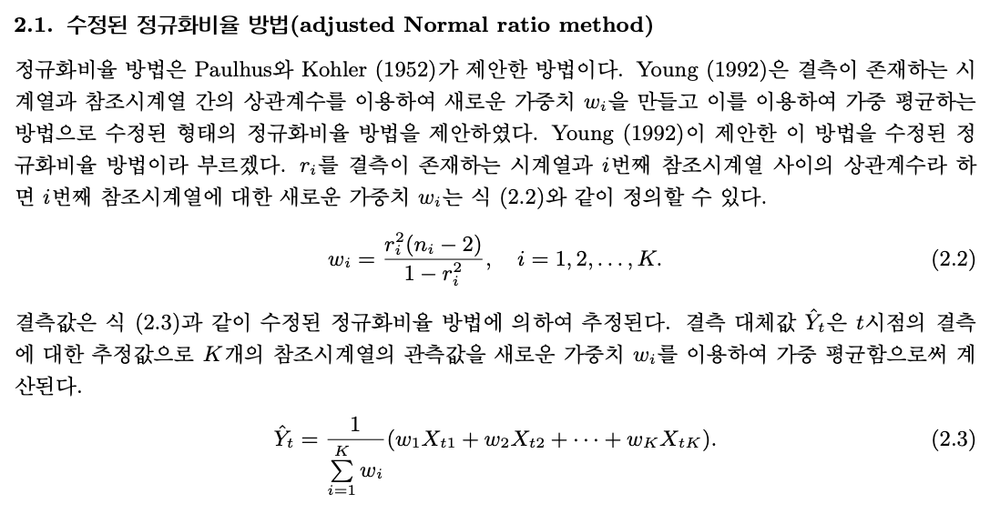

In [172]:
index = dateidx(df) #원래대로라면 함수로 만들긴 해야 하는데,,,
from datetime import date, timedelta
area3 = df[["stn_id", "address", "lat", "long", "add"]].drop_duplicates().reset_index(drop = True)

for i in range(index.shape[0]):
    print(index.loc[i, :])
    s = index.loc[i, "stn_id"]
    # less than 70km
    latlon = df.query("stn_id == @s")[["lat", "long"]].drop_duplicates().values[0]
    x = (np.cos(latlon[0]) * 6400 * 2 * np.pi / 360) * np.abs(latlon[1] - area3[["long"]])
    y = 111 * np.abs(latlon[0] - area3["lat"])
    area3["distance"] = np.sqrt((x**2).squeeze() + y**2)
    df1 = pd.merge(df, area3[["stn_id", "distance"]], on = "stn_id", how = "left").query("distance <= 70")
    # +- 30 Days from NaN
    st = int(str(date.fromisoformat(index.loc[i, "start"]) - timedelta(days = 30)).replace("-", ""))
    ed = int(str(index.loc[i, "start"]).replace("-", ""))
    idx = df1.query("yyyymmdd >= @st and yyyymmdd < @ed").reset_index(drop = True)
    st = int(str(index.loc[i, "end"]).replace("-", ""))
    ed = int(str(date.fromisoformat(index.loc[i, "end"]) + timedelta(days = 30)).replace("-", ""))
    idx = pd.concat([idx, df1.query("yyyymmdd > @st and yyyymmdd <= @ed").reset_index(drop = True)], axis = 0).reset_index(drop = True)
    idx = idx.pivot(index = "yyyymmdd", columns = "stn_id", values ="value")
    tg = idx.loc[:, s]
    idx = idx.drop(s, axis = 1)
    d_idx = []
    for j in idx.columns:
        d_idx.append([j, 1 - np.sum(np.abs(idx.loc[:, j] - tg)) / np.sum(np.abs(tg - np.nanmean(idx.loc[:, j])) + np.abs(idx.loc[:, j] - np.nanmean(idx.loc[:, j])))])
    stn_idx = pd.DataFrame(d_idx, columns = ["stn_id", "d_index"]).sort_values("d_index", ascending = False).head(n)["stn_id"].values
    print(stn_idx)
    ni = idx.loc[:, stn_idx].notnull().sum().values - 2
    ri2 = pd.concat([pd.DataFrame(tg), idx.loc[:, stn_idx]], axis = 1).corr().iloc[0, 1:].values ** 2
    wi = (ni * ri2) / (1 - ri2)
    #print(wi)
    wi = wi / np.sum(wi)
    #print(wi)
    st = int(str(index.loc[i, "start"]).replace("-", ""))
    ed = int(str(index.loc[i, "end"]).replace("-", ""))
    tg_idx = df[df["stn_id"] == s].query("yyyymmdd >= @st and yyyymmdd <= @ed").index
    ymd = df.loc[tg_idx, "yyyymmdd"].unique()
    d_idx = df.query("stn_id in @stn_idx and yyyymmdd in @ymd").pivot(index = "yyyymmdd", columns = "stn_id", values = "value")
    #print(d_idx)
    out = d_idx.loc[:, stn_idx[0]].values * wi[0]
    for k in range(1, len(stn_idx)):
        out += d_idx.loc[:, stn_idx[k]].values * wi[k]
        print(out)
    #print(df.loc[tg_idx, "value"])
    #print(len(out) == len(df.loc[tg_idx, "value"]))
    df.loc[tg_idx, "value"] = out

stn_id    4183025000
start     2011-04-30
end       2011-04-30
Name: 0, dtype: object
[4150025300 4125051000 4211025000 4211070500 1111058000]
[84.62083913]
[87.21459764]
[89.71870952]
[93.23696455]
stn_id    2714059000
start     2011-04-07
end       2011-04-30
Name: 1, dtype: object
[4719056500 4725052000 4711155000 4514053000 3111063000]
[53.76830027 31.320914   23.37358148 22.41383323 27.71155717 14.40741401
 15.23295896 15.93473538 27.59673908 28.31454542 26.41704283 35.37053569
 26.36652883 27.52944856 22.69640766 55.97540415 29.18557141 27.02245535
 28.02265169 58.57282108 44.37379594 31.76285651 29.31809706 50.04394092]
[58.45070385 35.7384885  25.90354442 24.30144478 31.90374521 15.99075385
 16.37679521 17.3321314  30.26756856 31.88692072 30.1979006  39.16266278
 29.79240293 30.97222665 24.57838455 61.2325432  32.0592487  29.13545336
 30.36667081 63.91448004 49.12945012 35.88179396 31.71282814 53.90368395]
[76.74131917 52.98923127 43.08001059 37.46697398 45.53350323 29.56480441

In [180]:
df.isnull().sum()

yyyymmdd    0
tma         0
add         0
address     0
value       0
stn_id      0
long        0
lat         0
dtype: int64

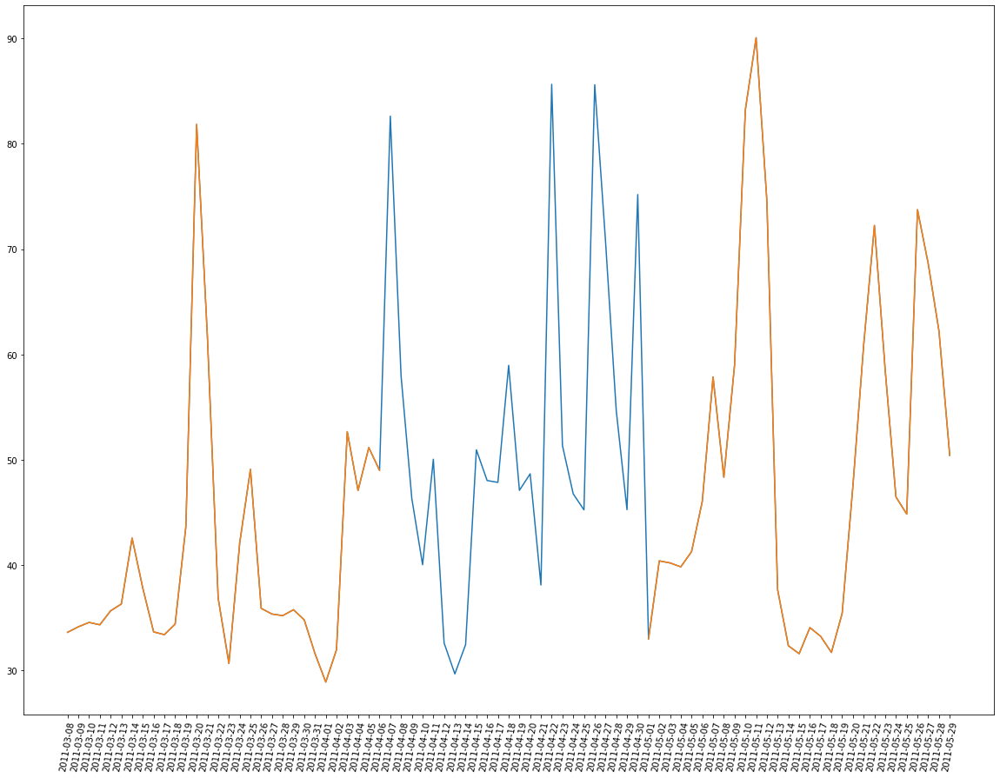

In [179]:
df1 = pd.read_csv("fore_ing.csv", encoding = "utf-8-sig")
plt.figure(figsize = (20, 15))
plt.plot(df[df["stn_id"] == 2714059000].query("yyyymmdd > 20110307 and yyyymmdd < 20110530")["tma"], df[df["stn_id"] == 2714059000].query("yyyymmdd > 20110307 and yyyymmdd < 20110530")["value"])
plt.plot(df[df["stn_id"] == 2714059000].query("yyyymmdd > 20110307 and yyyymmdd < 20110530")["tma"], df1[df1["stn_id"] == 2714059000].query("yyyymmdd > 20110307 and yyyymmdd < 20110530")["value"])
plt.xticks(rotation = 80)
plt.show()

In [181]:
df.to_csv("final_fore_rhm_0803_anr.csv", encoding = "utf-8-sig", index = False)